# Immune subtype annotation
- Plot markers and metadata (QC, study, ...)
- Proceed from fine to coarse clusters that seem reliable based on markers and embedding (e.g. some initial fine clusters that were determined based on OVR genes seemed missanotated - for example due to batch effects)

In [1]:
import pandas as pd
import scanpy as sc
import numpy as np

from collections import defaultdict
import re

import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sb
import colorcet as cc

In [2]:
path_data='/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/combined/'
path_genes='/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/gene_lists/'
path_save='/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/combined/ct_composition/subtypes/'

### Prepare data

In [ ]:
# Get immune cells
obs_names=sc.read(
    path_data+'data_integrated_analysed.h5ad',backed='r'
    ).obs.query('cell_type_integrated_v1=="immune"').index
obs_names.shape

In [ ]:
# Load rawnorm. Correctly norm expression is in layers X_sf_integrated
adata_rn=sc.read(path_data+'data_rawnorm_integrated_annotated.h5ad')[obs_names,:].copy()
adata_rn.X=adata_rn.layers['X_sf_integrated']

In [36]:
# remove unused layer
del adata_rn.layers

In [ ]:
# Redo embedding
sc.pp.neighbors(adata_rn, use_rep='X_integrated'  )
sc.tl.umap(adata_rn)

### Known markers

Cell type	Marker

Long-term hematopoietic stem cells (LT-HSC)	Sca-1+, CD117+, CD34-, CD48-, CD49blow, CD135-, CD150+

Intermediate-term hematopoietic stem cells (IT-HSC)	Sca-1+, CD117+, CD34-, CD49high, CD135-, CD150+

Short-term hemotopoietic stem cells (ST-HSC)	Sca-1+, CD117+, CD34+, CD48-, CD135-, CD150-

Multi-potent progenitor (MPP)	Sca-1+, CD117+, CD34+, CD48-, CD135+

Lymphoid-primed multi-potent progenitor (LMPP)	Sca-1+, CD117+, CD34+, CD127+, CD135+

Common lymphoid progenitor (CLP)	Sca-1+, CD117+, CD93+, CD127+, CD135+

Common myeloid progenitor (CMP)	CD117+, CD16/32-, CD34+, CD41+, Sca-1-

Granulocyte-monocyte progenitor (GMP)	CD117+, CD16/32+, CD34+, CD64+, Sca-1-

Megakaryocyte–erythroid progenitor (MEP)	CD117+, CD16/32-, CD34-, CD64-, CD127-, Sca-1-

Natural killer cell*	CD11b+, CD122+, NK1.1+, NKG2D+, NKp46+

T-cell*	CD3+

B-cell*	B220+

Monocyte*	CD11b+, CD115+, CX3CR1+, Ly6C+

Macrophage*	CD45+, CD64+, F4/80+, MerTK+

Dendritic cell*	CD11c+, CD24+, CD45+, MHC II+, Siglec-F-

Neutrophil	CD11b+, CXCR4+, MHC II-, Gr-1+ (Ly-6G+), Siglec-F-

Eosinophil	CCR3+, CD11b+, IL-5Rα+, MHC II-, Siglec-F+

Basophil	CD41+, CD49b+, CD117-, FcεRI+

Mast cell	CD45+, CD117+, FcεRI+, Integrin β7+

Erythrocyte	Ter119+

Megakaryocyte	CD9+, CD41+, CD42b+, CD117+, CD150+, CXCR4+

Platelet	CD9+, CD41+, GPIa/IIa+, GPIb/V/IX+, GPVI+

In [7]:
# orthologues
orthologues=pd.read_table(path_genes+'orthologues_ORGmus_musculus_ORG2homo_sapiens_V103.tsv'
                         ).rename(
    {'Gene name':'gs_mm','Human gene name':'gs_hs','Gene stable ID':'eid_mm'},axis=1)

In [23]:
# Human markers
markers_human={
    'macrophages': ['C1QA', 'CD14', 'CD74', 'LYVE1', 'FOLR2'],
    'dc1': ['CLEC9A', 'C1ORF54', 'CADM1', 'CAMK2D', 'IDO1', 'XCR1'],
    'dc2': ['CD1C', 'FCER1A', 'CLEC10A', 'ADAM8', 'CD1D', 'FCGR2B'],
    'dc3': ['S100A9', 'S100A8', 'VCAN', 'RNASE2', 'CD1C', 'FCER1A', 'CLEC10A'],
    'dc4': ['FCGR3A','FTL','SERPINA1','LST1','AIF1','LILRB2', 'TMEM176B',
            'LOC200772','CLEC4F'],
    'dc5': ['AXL', 'PPP1R14A', 'SIGLEC6', 'CD22', 'CD5', 'SIGLEC1'],
    'dc6': ['GZMB', 'IGJ', 'AK128525', 'SERPINF1', 'ITM2C', 'TCF4', 'CLEC4C', 'NRP1'],
    'mono1': ['CD14', 'VCAN', 'S100A8', 'S100A9', 'FCN1', 'ITGAM'],
    'mono2': ['LAIR2', 'ASAH1', 'APOBEC3A', 'TSPAN14', 'LIPA', 'ITGAM'],
    'mono3':  ['G0S2', 'CXCR1', 'CXCR2','NAMPT','NEAT1', 'AL137655','CSF3R',
         'CD14','VCAN','S100A8','S100A9','FCN1', 'ITGAM'], #also shares signature with Mono1
    'mono4': ['PRF1','GNLY','CTSW','FGFBP2','IL2RB','GZMA','CD14',
         'VCAN','S100A8','S100A9','FCN1', 'ITGAM'] #also shares signature with Mono1
 }

In [24]:
# Mouse markers
genes=set()

In [25]:
# Map human to mouse. print missing orthologues
for g in [g for gs in markers_human.values() for g in gs]:
    mm_gss=orthologues.query('gs_hs==@g')['gs_mm']
    if len(mm_gss)==0:
        print(g)
    else:
        genes.update(mm_gss)

C1ORF54
CAMK2D
CD1C
CD1C
LILRB2
LOC200772
GZMB
IGJ
AK128525
LAIR2
APOBEC3A
CXCR2
NEAT1
AL137655
GNLY
FGFBP2


In [26]:
# Add orthologues of genes that could not be mapped with orthologues table
genes.update(['BC028528','Camk2d','Gzmb','Jchain','Lair1','Cxcr2','Neat1'])

In [27]:
# Add mouse markers
genes.update(['Adgre1','Ccr3','Cd3e','Cd9','Itgam','Itgax','Fcgr3','Cd24a','Fcgr2b',
              'Cd34','Itga2b','Gp1ba','Cd48',
              'Fcgr1','Cd93','Csf1r','Kit',
              'Il2rb','Il7r',
              'Flt3','Slamf1','Siglecf','Cx3cr1','Cxcr4','Fcer1a','Gp1ba','Gp1bb','Gp6',
              'Gsr','H2',
              'Il5ra','Itga2','Itgb7','Klrb1c',
              'Klrk1','Ly6a','Ly6c','Ly6g','Ly76','Mertk','Ncr1','Ptprc'])

C: 
C1orf54 -> BC028528

In [8]:
# genes still without correct symbol
genes_all=set(adata_rn.var.gene_symbol)

In [29]:
[g for g in genes if g not in genes_all]

['H2', 'Cd1d2', 'Ly6c', 'Ly76']

C: Also could not match them with EIDs

Plot genes on UMAP 

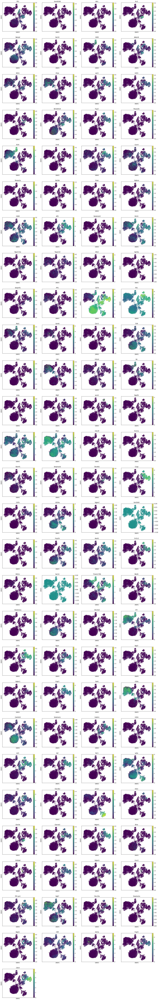

In [13]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata_rn,color=[g for g in genes if g in genes_all],gene_symbols='gene_symbol',s=10)

Detailed DC markers

In [38]:
genes_dc_human={
    'DC1': ['CLEC9A', 'C1ORF54', 'CADM1', 'CAMK2D', 'IDO1', 'XCR1'],
    'DC2': ['CD1C', 'FCER1A', 'CLEC10A', 'ADAM8', 'CD1D', 'FCGR2B'],
    'DC3': ['S100A9', 'S100A8', 'VCAN', 'RNASE2', 'CD1C', 'FCER1A', 'CLEC10A'],
    'DC4': ['FCGR3A','FTL','SERPINA1','LST1', 'AIF1','LILRB2','TMEM176B',
         'LOC200772','CLEC4F'],
    'DC5': ['AXL', 'PPP1R14A', 'SIGLEC6', 'CD22', 'CD5', 'SIGLEC1'],
    'DC6': ['GZMB', 'IGJ', 'AK128525', 'SERPINF1', 'ITM2C', 'TCF4', 'CLEC4C', 'NRP1'],
}

In [52]:
genes_dc=defaultdict(set)

In [53]:
# Map human to mouse. print missing orthologues
for group,gs in genes_dc_human.items():
    for g in gs:
        mm_gss=orthologues.query('gs_hs ==@g')['gs_mm']
        if len(mm_gss)==0:
            print('Missing:',group,g)
        else:
            genes_dc[group].update(mm_gss)

Missing: DC1 C1ORF54
Missing: DC1 CAMK2D
Missing: DC2 CD1C
Missing: DC3 CD1C
Missing: DC4 LILRB2
Missing: DC4 LOC200772
Missing: DC6 GZMB
Missing: DC6 IGJ
Missing: DC6 AK128525


In [54]:
# Add mouse genes that could not be directly mapped
genes_dc['DC1'].update(['BC028528','Camk2d'])
genes_dc['DC4'].update(['Lilra6','Pirb','Gm15922','Pira2','Pira12','Gm15448'])
genes_dc['DC6'].update(['Gzmb','Jchain'])

In [55]:
# genes still without correct symbol
[g for gs in genes_dc.values() for g in gs if g not in genes_all]

['Cd1d2', 'Gm15922', 'Pira12']

DC1


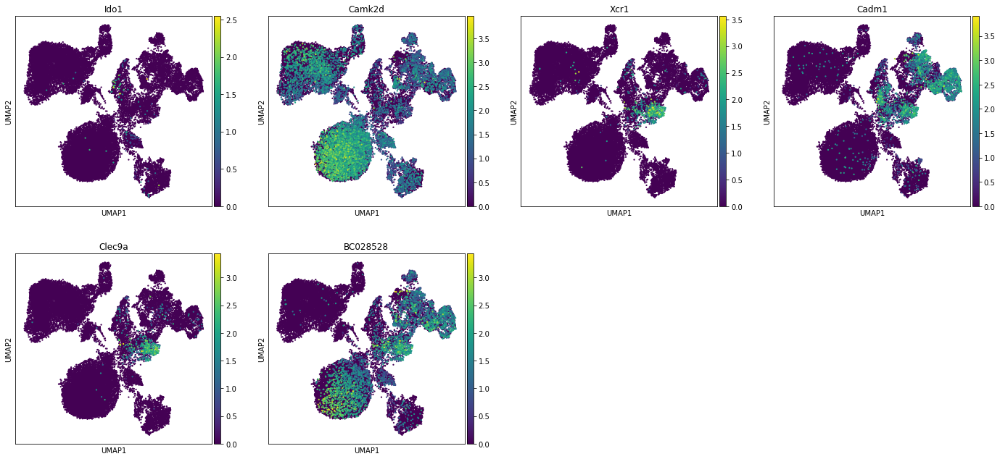

DC2


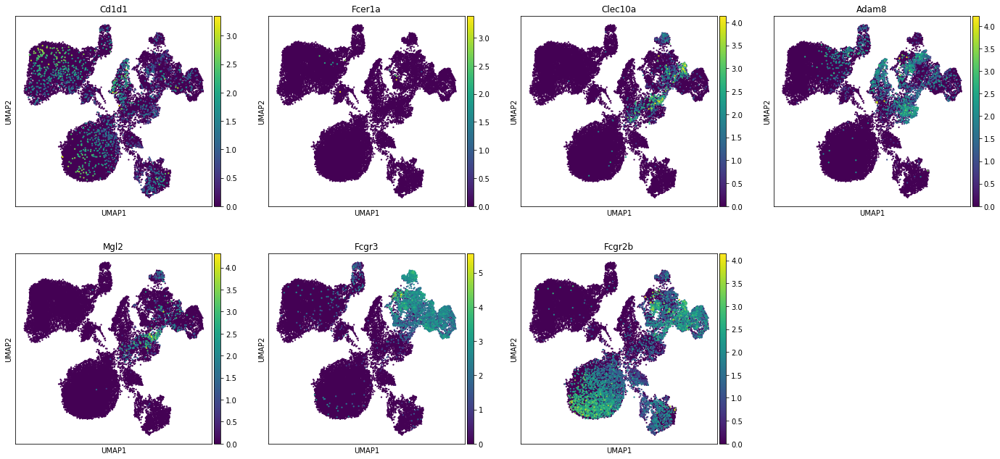

DC3


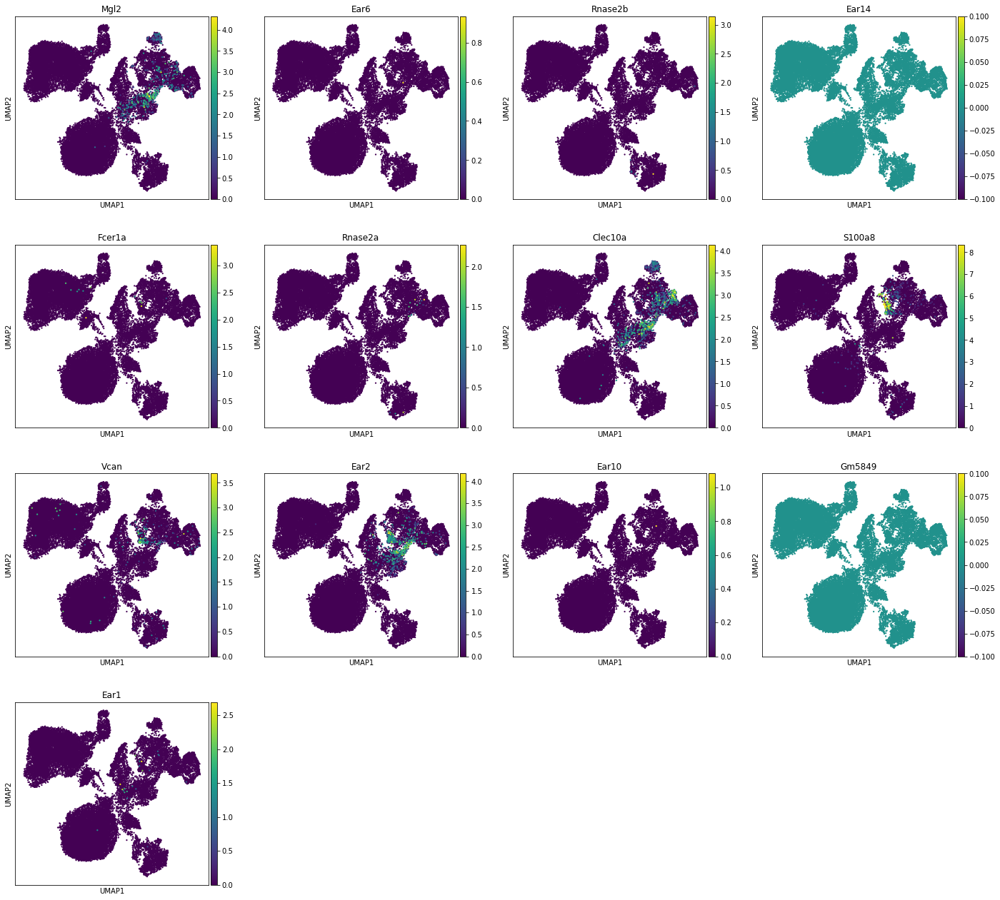

DC4


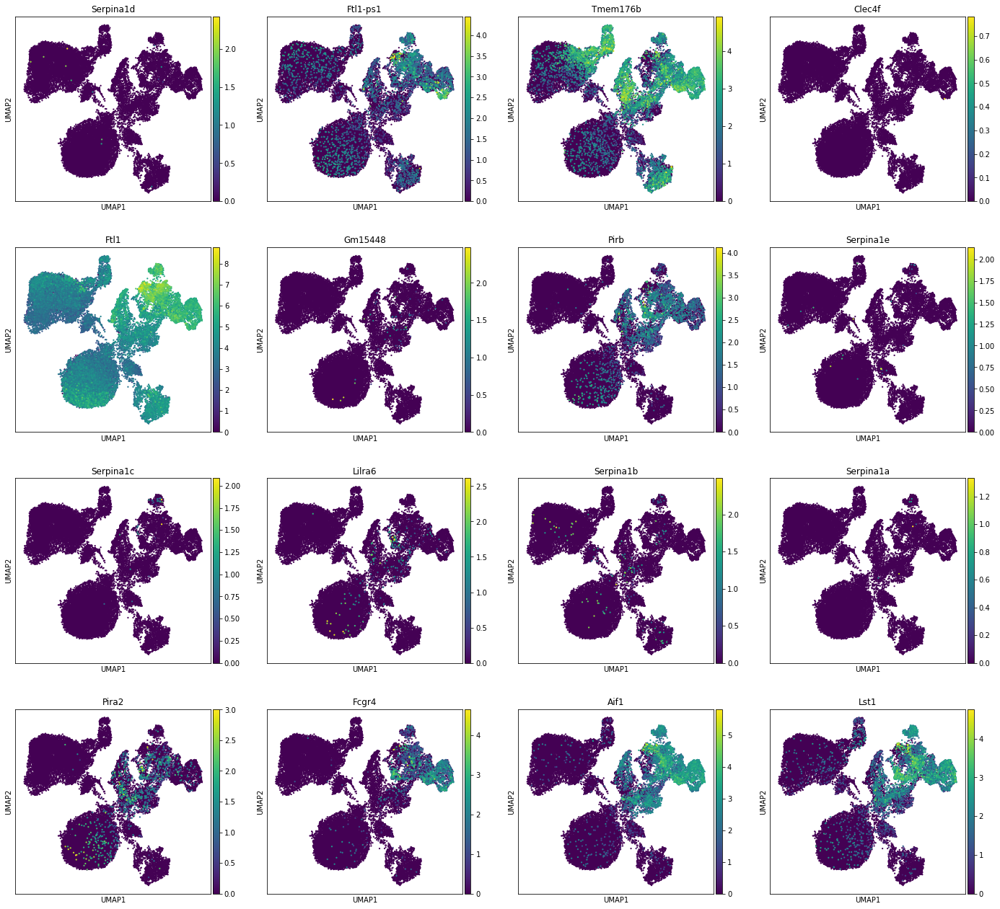

DC5


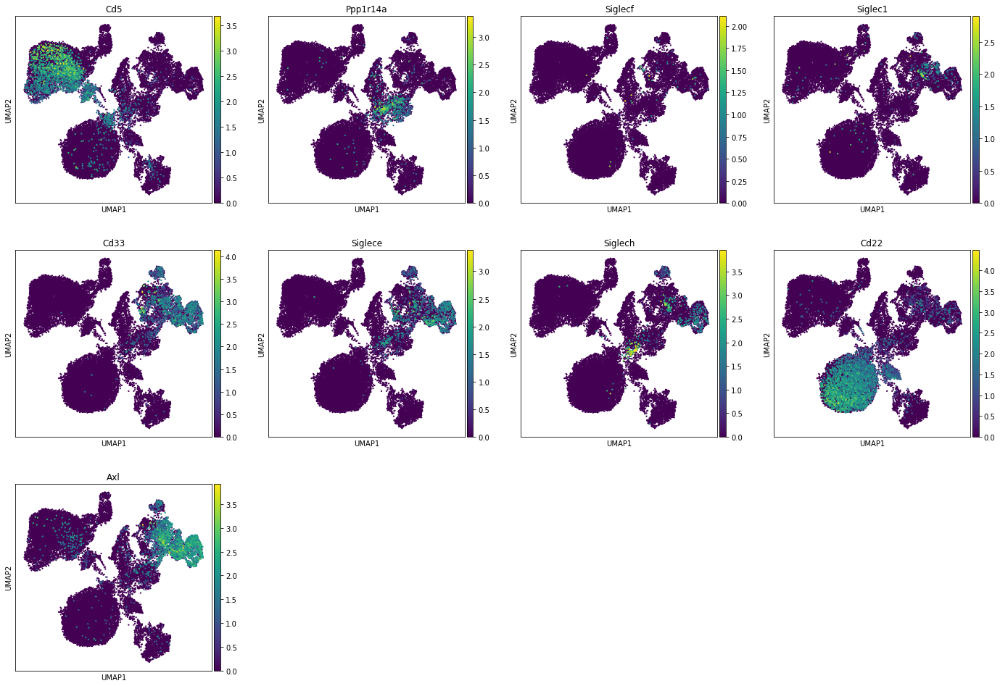

DC6


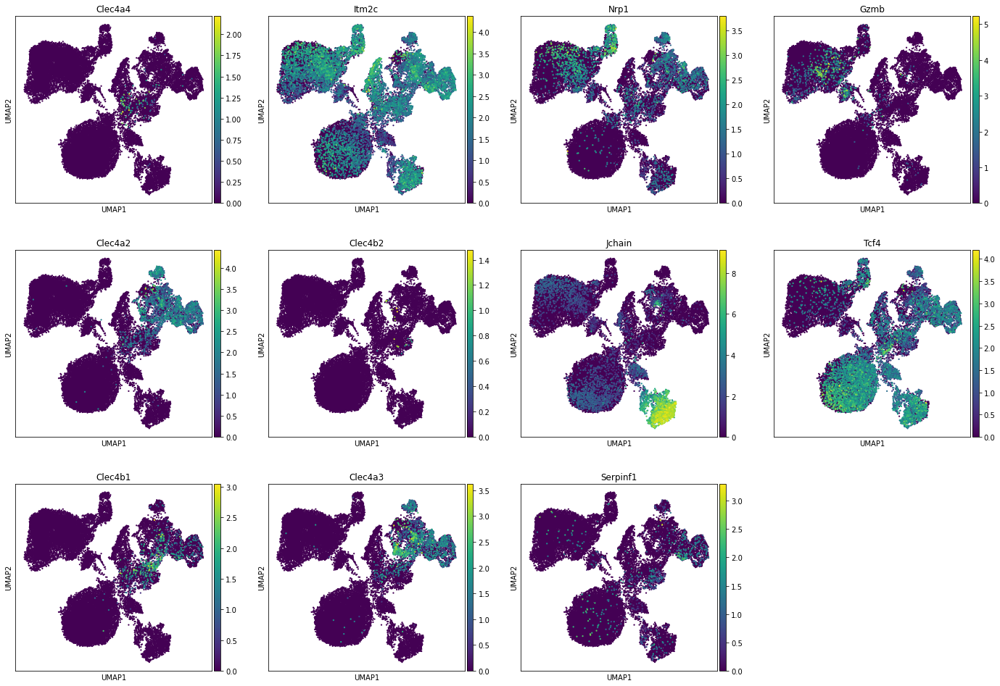

In [58]:
for group,gs in genes_dc.items():
    rcParams['figure.figsize']=(5,5)
    print(group)
    sc.pl.umap(adata_rn,color=[g for g in gs if g in genes_all],
               gene_symbols='gene_symbol',s=20)

In [11]:
# Further immune markers
hs_markers = {
    'Monocyte':['MERTK','CD14','CD74'],
    'B':['MS4A1', 'CD19','IGKC','IGHM','ENTPD1'],
    'T':['CD3D'],
    'NK':['KLRC1','EOMES', 'PRF1', 'NKG7', 'KIR3DL1','GNLY','FGFBP2','ARL4C'],
    'Neutrophils':['IFTM2','CSF3R','FCGR3B','NAMPT','CXCR2'],
    'Immature neutrophils':['LTF','DEFA3','LCN2','BPI','CAMP'],
    'Monocytes':['FCN1','VCAN','PSAP','DUSP6'],
    'Eosinophils':['CLC','FCER1A','HDC','GATA2','CSF2RB'],
    'DC':['HLA-DRA','HLA-DPA','HLA-DFB1','HLA-DRB2'],
    'cDC1':['CLEC9A'],
    'cDC2':['CLEC10A'],
    'Plasma':['XBP1'],
    'Plasmacytoid DCs':['CLEC4C'],
    'Common lymphoid progenitor':['CD34', 'SPINK2', 'FLT3'], #fetal
    'Pro-B':['DNTT', 'RAG1', 'RAG2', 'CD79B', 'VPREB1', 'VPREB3', 'IGLL1'],  #fetal #'DNTT' (TdT)
    'Pre-B':['CD38', 'CD19'], #CD19 higher than pro; #fetal
    'Immature B':['MS4A1', 'IGHM', 'IGHD'], #fetal
    'Naive B':['FCMR'],
    'Memory B':['SELL'],
    'Follicular B':['IGHD'],
    'Memory B tissue':['FCRL4'],
    'Plasma IgA IGKC+':['XBP1','MZB1','SDC1', 'IGHA1', 'IGHA2', 'IGKC'],
    'Plasma IgG IGKC+':['XBP1','MZB1','SDC1', 'IGHG1', 'IGHG2','IGHG3', 'IGKC'],
    'Plasma IgM IGKC+':['XBP1','MZB1','SDC1', 'IGHM', 'IGKC'],
    'Cycling B':['MKI67', 'HMGB2', 'TUBA1B', 'UBE2C'],
    'B naive':['MS4A1','IGHD', 'TCL1A', 'FCER2'],
    'B intermediate':['MS4A1','LINC01857'],
    'B memory':['MS4A1','LINC01781', 'SSPN'],
    'B cycling':['MS4A1','TCL1A','CDCA8', 'CDC20', 'UBE2C'], #last 3 G2M and S phase genes
    'B int_mem':['MS4A1','LINC01781', 'SSPN', 'LINC01857'],
    'Plasmablast':['IGKC', 'JCHAIN', 'IGHA1'],
    'Plasma':['XBP1', 'MZB1'],
    'Platelet':['PF4', 'PPBP', 'NRGN', 'TUBB1', 'MPIG6B', 'CAVIN2', 'SPARC'],
    'cDC1':['C1orf54', 'CLEC9A', 'IDO1', 'DNASE1L3'],
    'cDC2':['CD1C', 'FCER1A', 'CLEC10A'],
    'pDC':['IRF8', 'TCF4', 'CCDC50', 'UGCG', 'PLD4', 'LILRA4', 'SERPINF1', 'CLEC4C'],
    'Eryth':['HBB', 'HBA1', 'HBA2', 'SLC25A39', 'ALAS2'],
    'HSPC':['CD34', 'PRSS57', 'CYTL1'],
    'CD4 T':['CD4','IL7R'],
    'CD8 T':['CD8A'],
    'naive/central memory':['SELL'], # for CD4 and CD8
    'activated':['CD69'], # for CD4 and CD8
    'TH1':['CXCR3','IFNG'], # also IL22, IL26
    'TH17':['RORA','IL22', 'MS4A1'], # also IL22, IL26 #RORAhi
    'Treg':['FOXP3', 'CTLA4', 'TIGIT'],
    'T follicular helper':['CXCR5', 'PDCD1'],
    'CD8 T memory':['FGFBP2', 'S1PR5', 'FCGR3A', 'TGFBR3'], # subset of CX3CR1 expressing
    
    'gdT':['EPCAM','IL17A','IL12A','CD27','KLRK1','KLRG1','CD94','CD3G','CD3D'],
    'NK T':['GZMA', 'NKG7', 'PRF1'],
    'MAIT':['TRAV1-1','TRAV1-2', 'TRAV2', 'SLC4A10'],
    'ILC2':['PTGDR2', 'HPGDS', 'IL1RL1', 'KRT1'],
    
    'NK':['EOMES', 'PRF1', 'NKG7', 'KIR3DL1', 'KIR2DL1'], 
    # ILC bsence of rearranged antigen receptors found on T cells and B cells 
    #    (due to the lack of the RAG gene), 
    #    and phenotypic markers usually present on myeloid or dendritic cells.
    'ILC3':['RORC', 'IL1R1', 'IL23R', 'KIT', 'TNFSF4', 'PCDH9'], # subdivided into LTi-like NCR+ ILC3 with TNFRSF11A (RANK) and its ligand TNFSF11 (RANKL), as well as NCR1 (NKp46) and NCR2 (NKp44), whereas LTi-like NCR- ILC3s lacked NCR2 (NKp44) and expressed IL17A, ITGAE and CCR9, and NK-associated genes including NKG7, PRF1 and GZMA, consistent with NCR− ILC3 cells described in mice
    'ILCP':['IL7R', 'KIT', 'RORC', 'CCR6', 'NRP1', 'CXCR5', 'CCR7', 'SCN1B', 'HPN'], # but not NCR2 as described in the liver
        'CD4 naive':['CD3D', 'TCF7', 'CCR7', 'CD4'], # NO CD8A, CD8B
    'CD8 naive':['CD3D', 'CD8B', 'TCF7', 'CCR7'],
    'CD8 TEM':['CD3D', 'CD8B', 'GZMB', 'GZMH', ],
    'CD4 TEM':['CD3D', 'GZMK', 'GZMA', 'CD4'], # NO CD8A, CD8B (CD8 TEM) & no SLC4A10, NCR3 (MAIT)
    'CD8 TCM':['CD3D', 'ANXA2', 'IL7R', 'IL32', 'CD8B'],
    'CD4 TCM':['CD3D', 'ANXA2', 'IL7R', 'IL32', 'CD4'], # NO CD8A, CD8B, NO GZMK, GZMA
    'CD4 CTL':['CD3D', 'GNLY', 'NKG7', 'GZMH', 'FGFBP2', 'CD4'], # NO CD8A, CD8B
    'Treg':['CD3D', 'FOXP3', 'TIGIT'],
    'gdT':['CD3D', 'TRDC'], # no CD8A CD8B, can have NK markers, TRDC rather low expressed
    'MAIT':['SLC4A10', 'NCR3','KLRB1','CD8A'],
    'T cycling':['CD3D', 'TCF7', 'ANP32E'], # last one G2M and S phase gene
    'NK':['KLRC1', 'GNLY', 'NKG7', 'CLIC3', 'FGFBP2', 'GZMB', 'SPON2'], # later 3 for mature NK cells
    'NK_CD56bright':['GNLY','XCL1', 'SPTSSB', 'XCL2', 'NCAM1'],
    
    # Immune intestine specific
    'CD4 IL17+':['CD3D', 'IL17A'],
    'NK_select':['CD8B', 'CD4', 'KLRC1'],
        
    'Classical monocytes':['FCN1', 'S100A4', 'S100A6'],
    'Mast':['SLC38A2', 'CPA3', 'HPGDS'],
    'Megakaryocytes':['GP9', 'LCN2'],
    'cDC1':['CLEC9A'],
    'cDC2':['CLEC10A'],
    'Lymphoid DC':['LAMP3'],
    'Plasmacytoid DCs':['CLEC4C', 'JCHAIN'],
    'Classical macrophages ':['CD163', 'C1QB', 'C1QC'],
    'LYVE1+ macrophages':['RNASE1', 'SPP1'],
    'Inflammatory macrophages':['MMP9'],
        'CD16 Mono':['FCGR3A', 'MS4A7', 'CDKN1C', 'TCF7L2'],
    'CD14 Mono':['LYZ', 'VCAN', 'CD14', 'S100A8', 'S100A9'],
    'DC1_2': ['CD1C', 'CD1E', 'C1orf54', 'CLEC9A', 'FCER1A'],
    'pDC':['LILRA4'], #
    'macrophages': ['C1QA', 'C1QB', 'C1QC', 'MS4A4A'], # subset of CD 14
    'mast cell':['KIT', 'TPSAB1', 'SLC18A2', 'HDC', 'KRT1', 'CTSG', 'CPA3', 'MS4A2'],
        'Mast CPA3+':['CPA3','HPGDS', 'TPSAB1', 'HDC'],
    'CD14 Mono VCAN+':['FCN1','VCAN', 'S100A8'],
    'CD16 Mono CDKN1C+':['FCN1','FCGR3A', 'CDKN1C'],
    'cDC1 CLEC9A+':['CLEC9A'],
    'cDC2 CLEC10A+':['CLEC10A'],
    'Lymphoid DC LAMP3+':['LAMP3'],
    'pDC LILRA4+':['CLEC4C','LILRA4', 'TCF4', 'PLD4'],
    
    'Macrophages':['CD163','C1QA', 'C1QB', 'C1QC'],
    'LYVE1+ macrophages':['RNASE1','SPP1'],
    'Inflammatory macrophages':['MMP9'],
    
    'Megakaryocytes GP9':['GP9','PF4', 'PPBP'],
}

In [12]:
markers=defaultdict(set)

# Map human to mouse. print missing orthologues
for group,gs in hs_markers.items():
    for g in gs:
        mm_gss=orthologues.query('gs_hs ==@g')['gs_mm']
        if len(mm_gss)==0:
            print('Missing:',group,g)
        else:
            markers[group].update(mm_gss)

Missing: NK GNLY
Missing: NK FGFBP2
Missing: NK GZMB
Missing: Neutrophils IFTM2
Missing: Neutrophils CXCR2
Missing: Eosinophils CLC
Missing: DC HLA-DPA
Missing: DC HLA-DFB1
Missing: DC HLA-DRB2
Missing: Immature B IGHD
Missing: Follicular B IGHD
Missing: Memory B tissue FCRL4
Missing: Plasma IgG IGKC+ IGHG1
Missing: Plasma IgG IGKC+ IGHG2
Missing: Plasma IgG IGKC+ IGHG3
Missing: B naive IGHD
Missing: B intermediate LINC01857
Missing: B memory LINC01781
Missing: B int_mem LINC01781
Missing: B int_mem LINC01857
Missing: Platelet PF4
Missing: Eryth HBB
Missing: CD8 T memory FGFBP2
Missing: MAIT NCR3
Missing: CD8 TEM GZMB
Missing: CD8 TCM IL32
Missing: CD4 TCM IL32
Missing: CD4 CTL GNLY
Missing: CD4 CTL FGFBP2
Missing: NK_CD56bright GNLY
Missing: NK_CD56bright SPTSSB
Missing: Lymphoid DC LAMP3
Missing: DC1_2 CD1C
Missing: DC1_2 CD1E
Missing: mast cell TPSAB1
Missing: Mast CPA3+ TPSAB1
Missing: Lymphoid DC LAMP3+ LAMP3
Missing: Megakaryocytes GP9 PF4


Monocyte


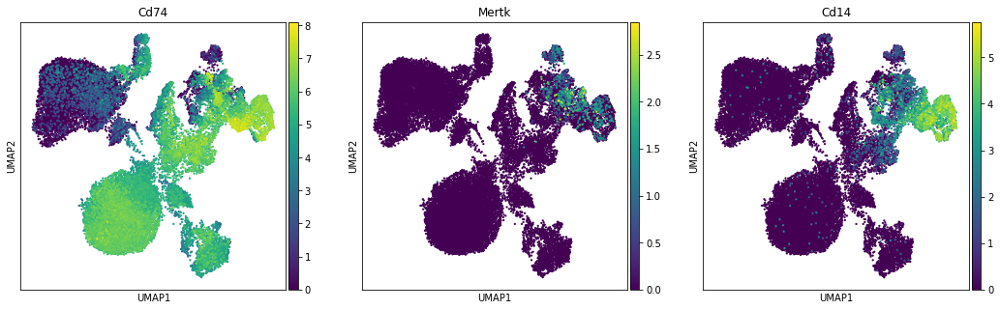

B


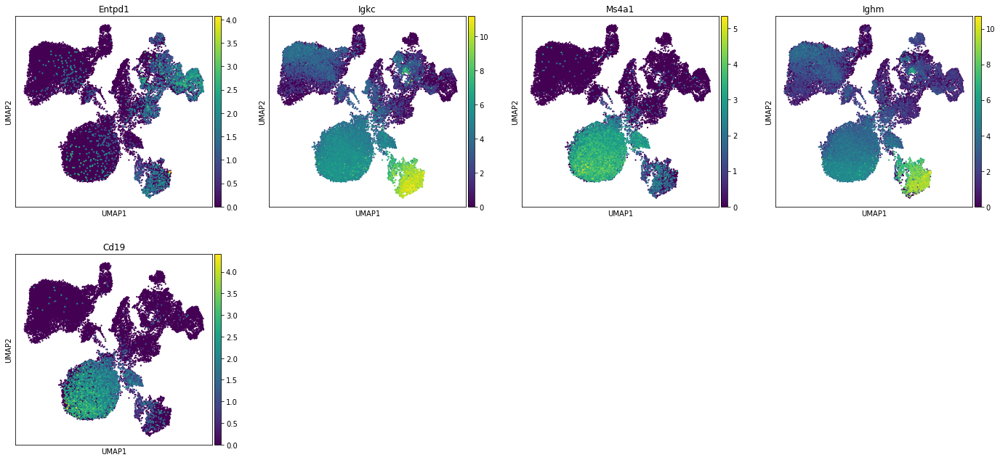

T


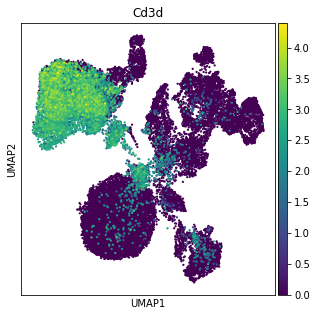

NK


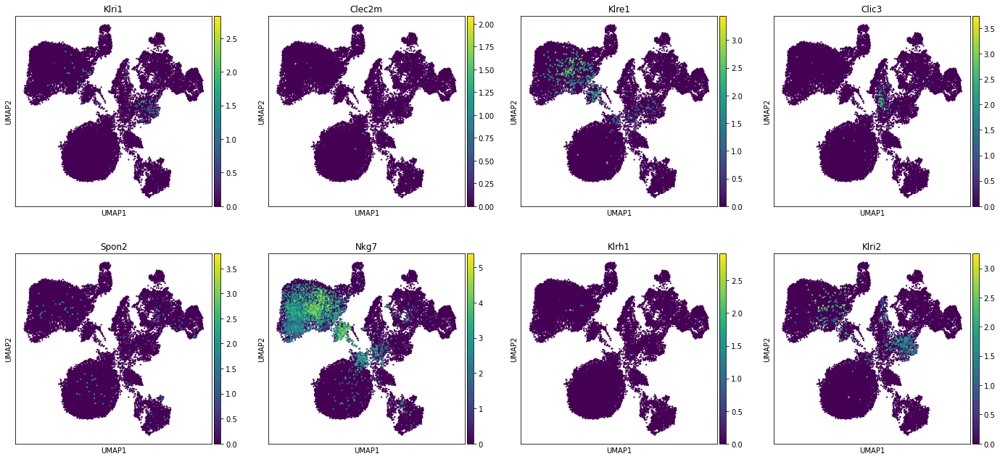

Neutrophils


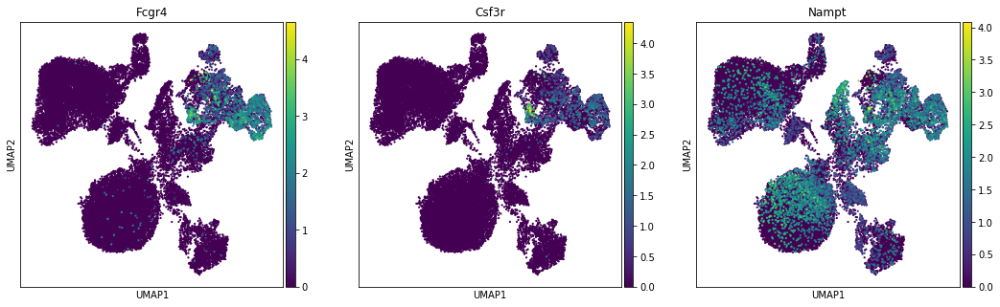

Immature neutrophils


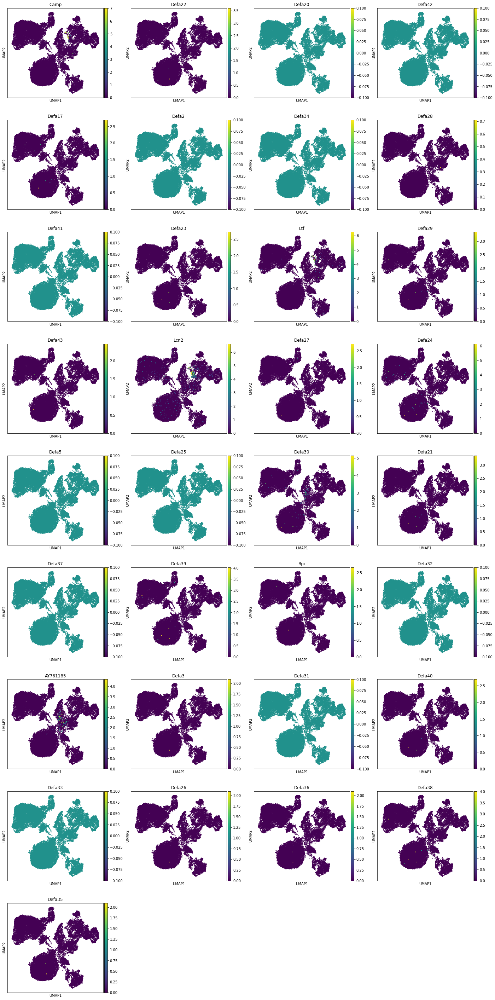

Monocytes


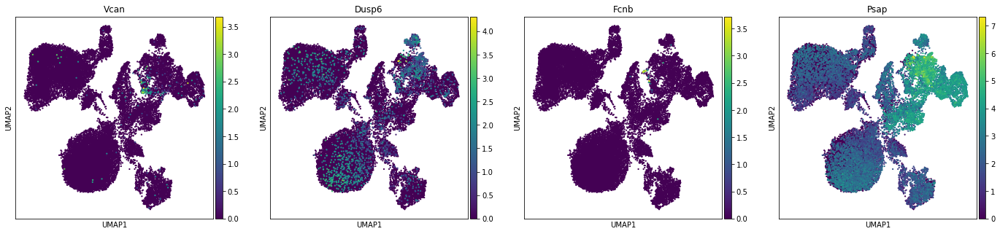

Eosinophils


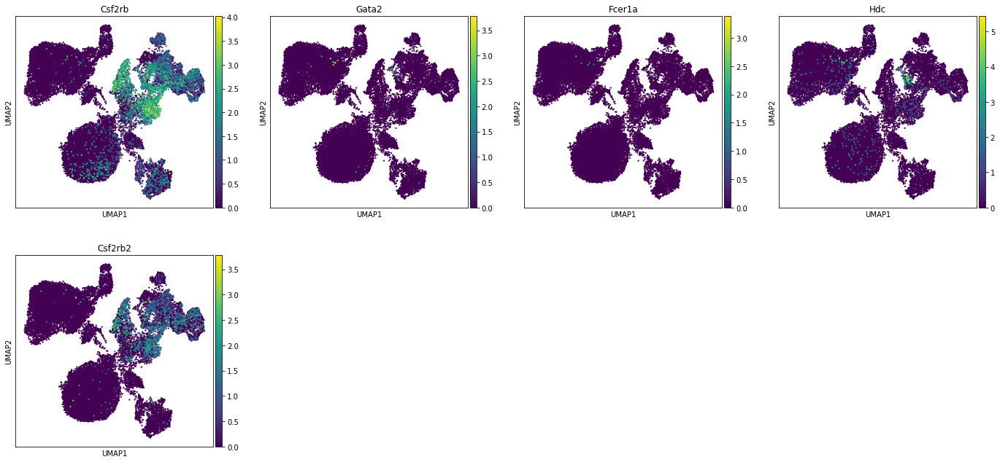

DC


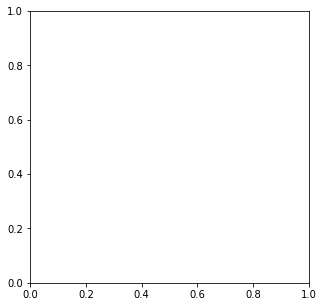

cDC1


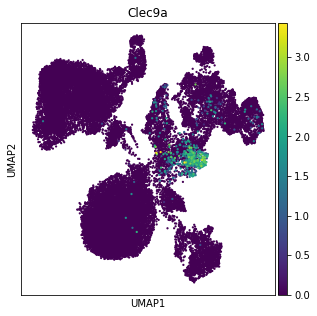

cDC2


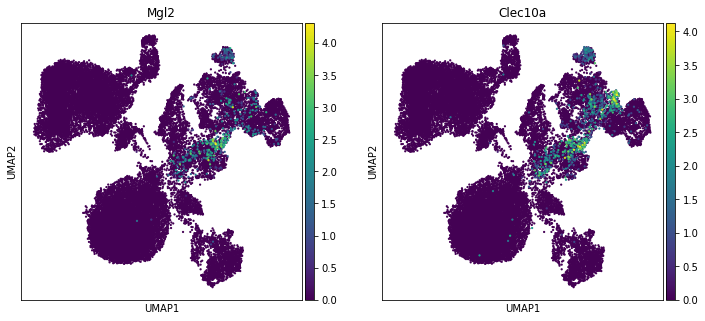

Plasma


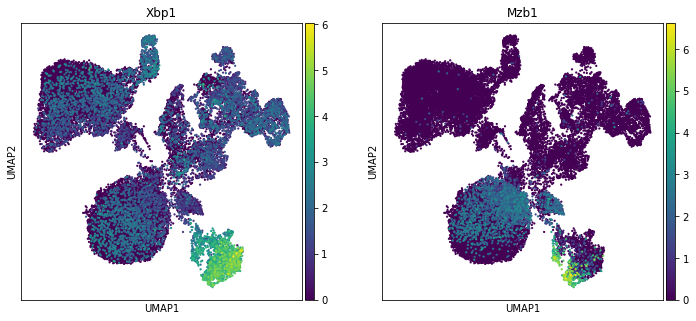

Plasmacytoid DCs


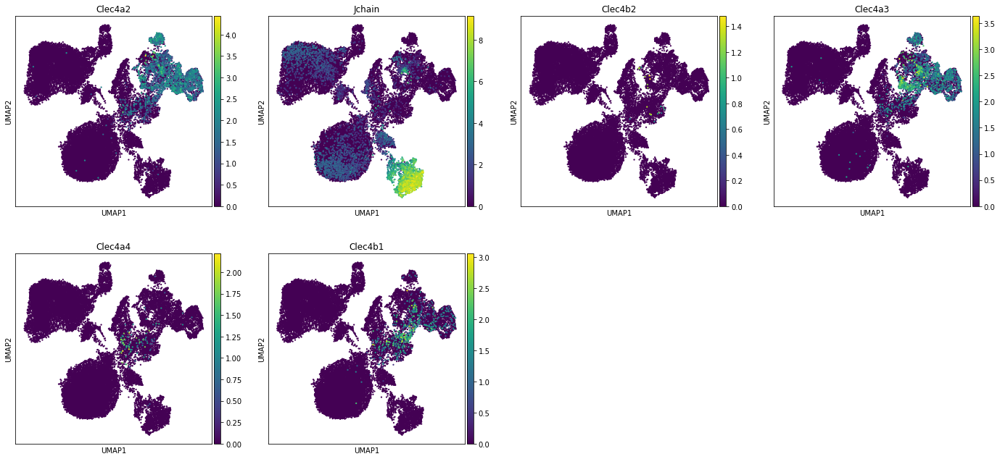

Common lymphoid progenitor


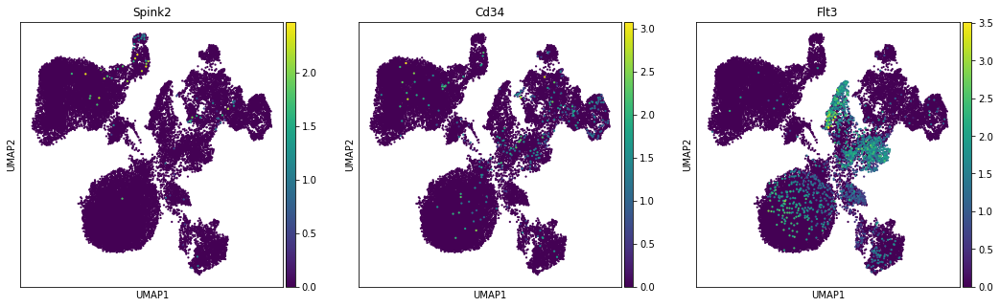

Pro-B


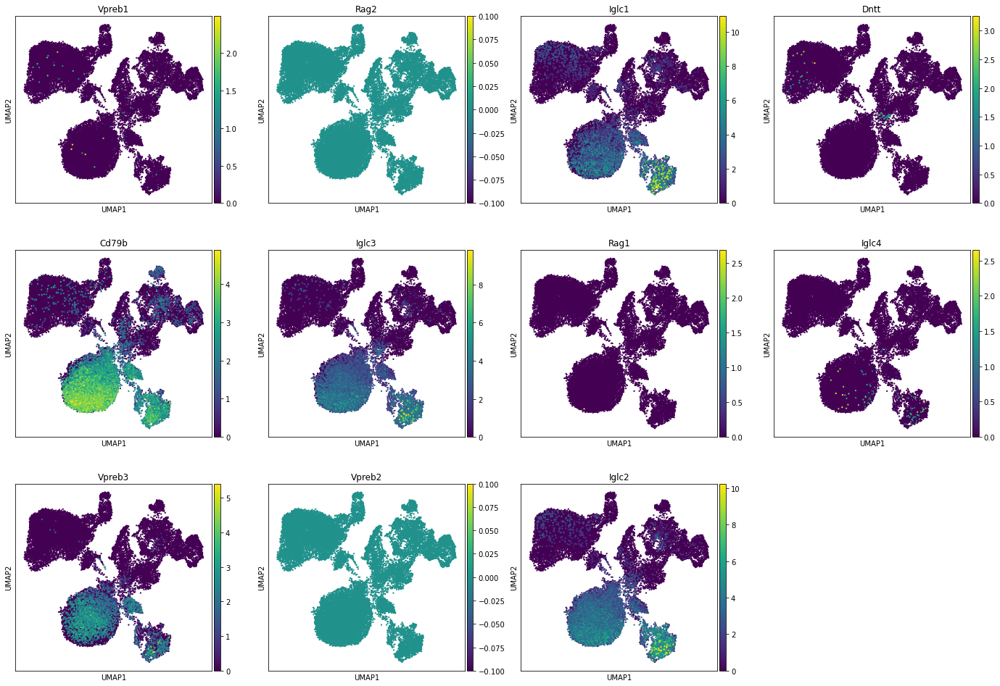

Pre-B


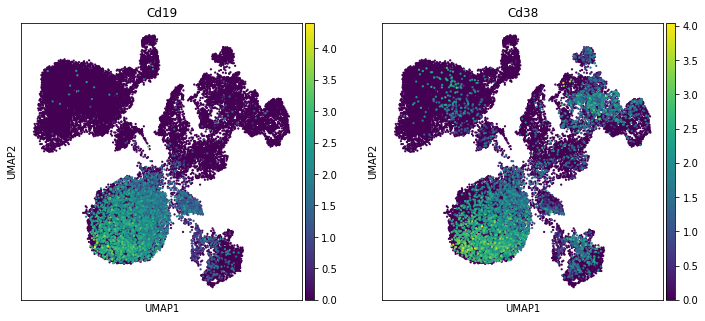

Immature B


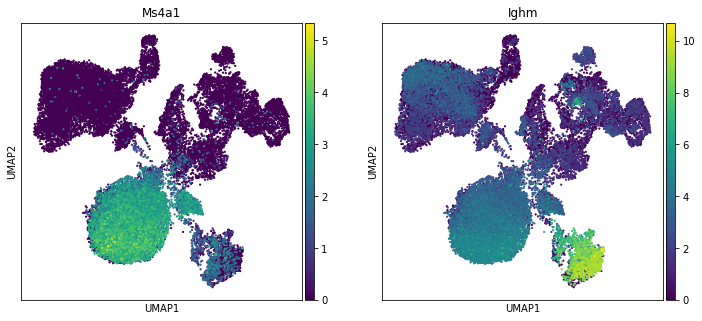

Naive B


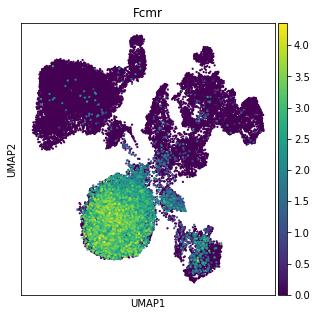

Memory B


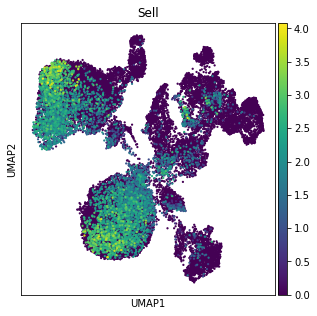

Plasma IgA IGKC+


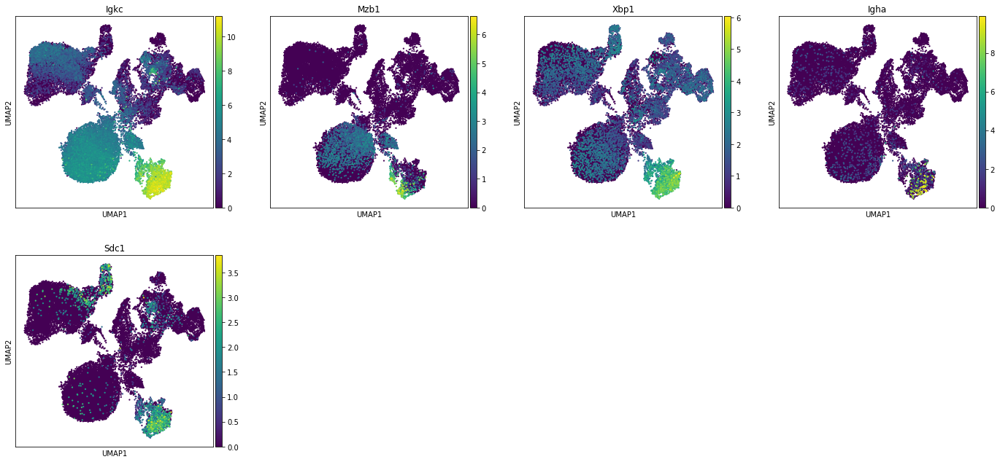

Plasma IgG IGKC+


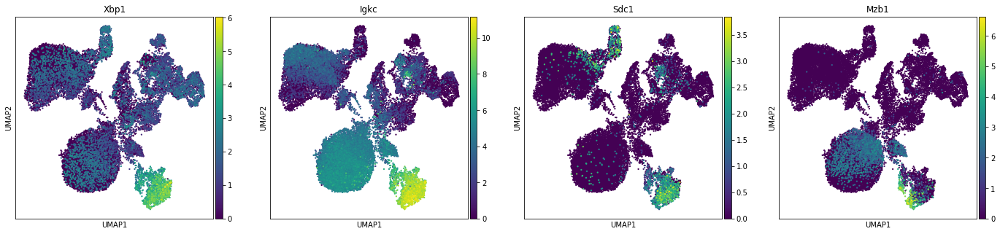

Plasma IgM IGKC+


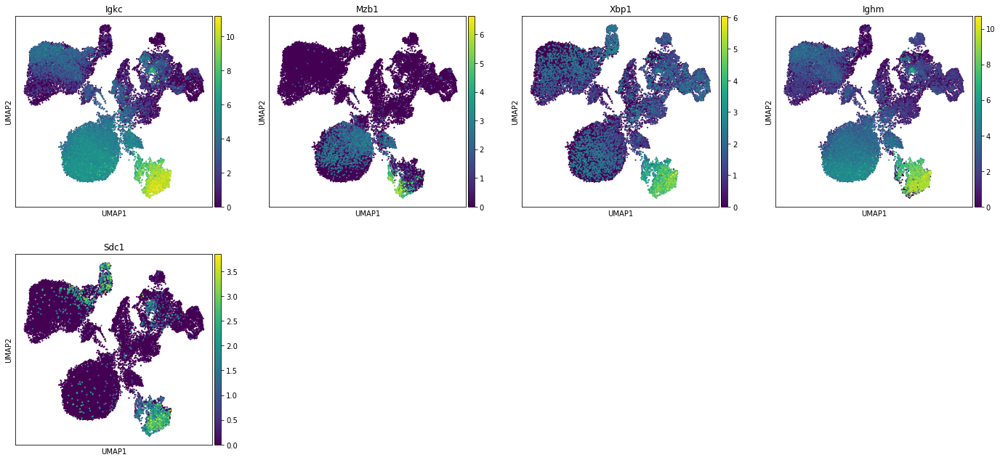

Cycling B


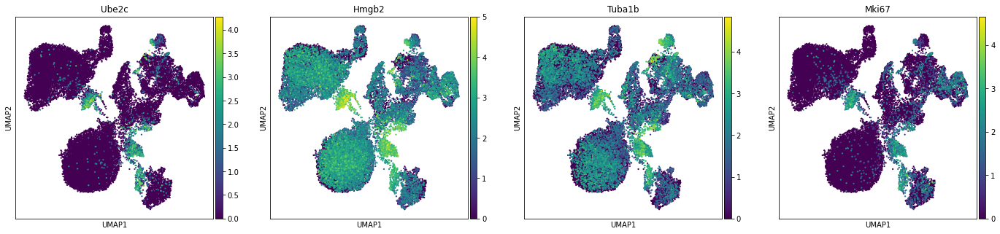

B naive


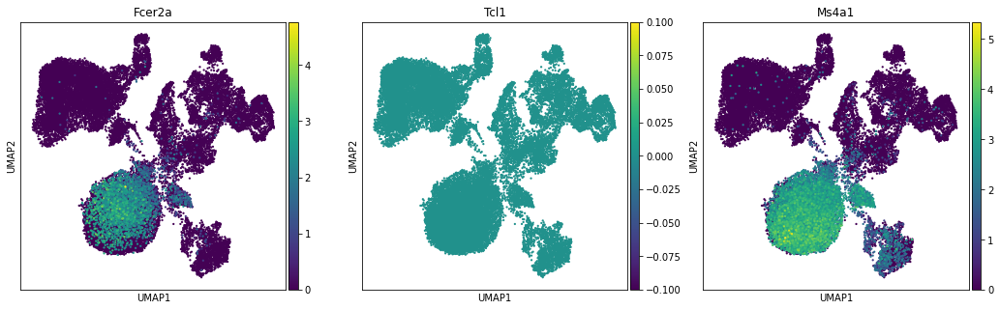

B intermediate


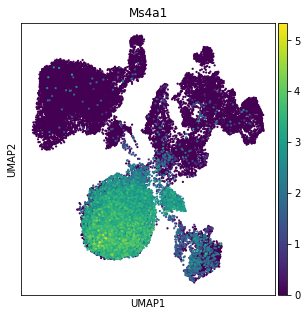

B memory


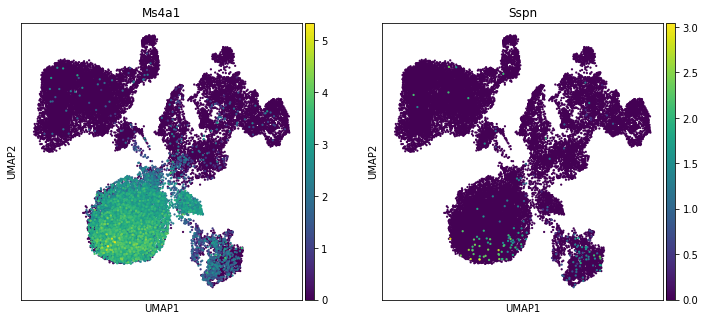

B cycling


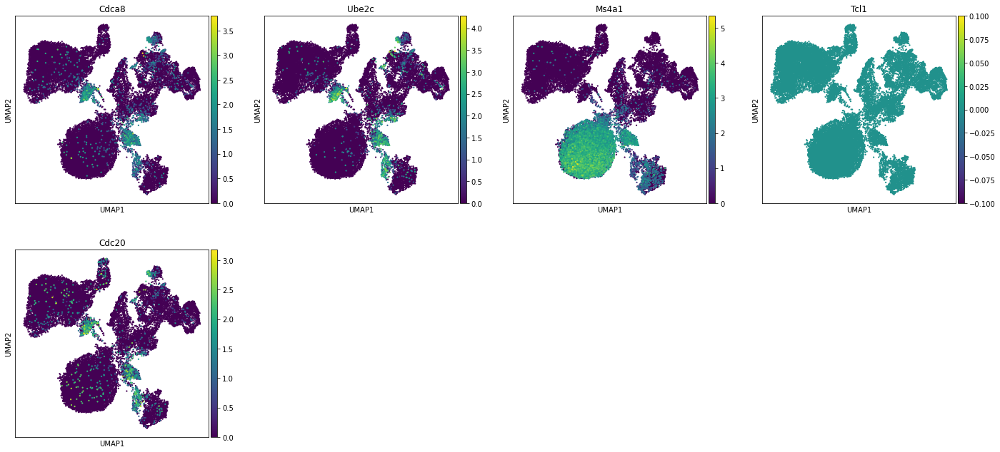

B int_mem


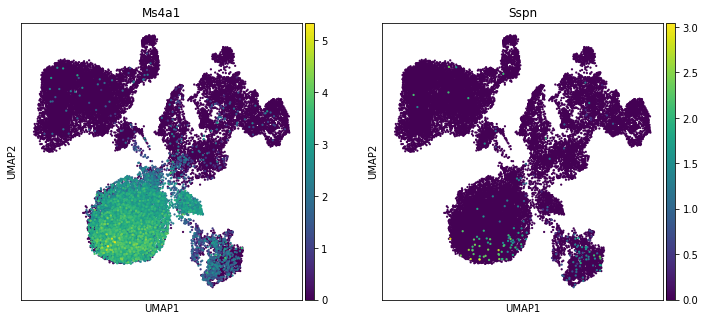

Plasmablast


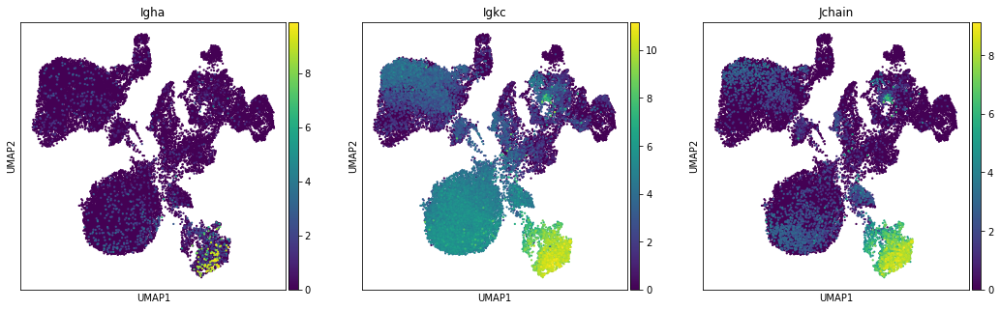

Platelet


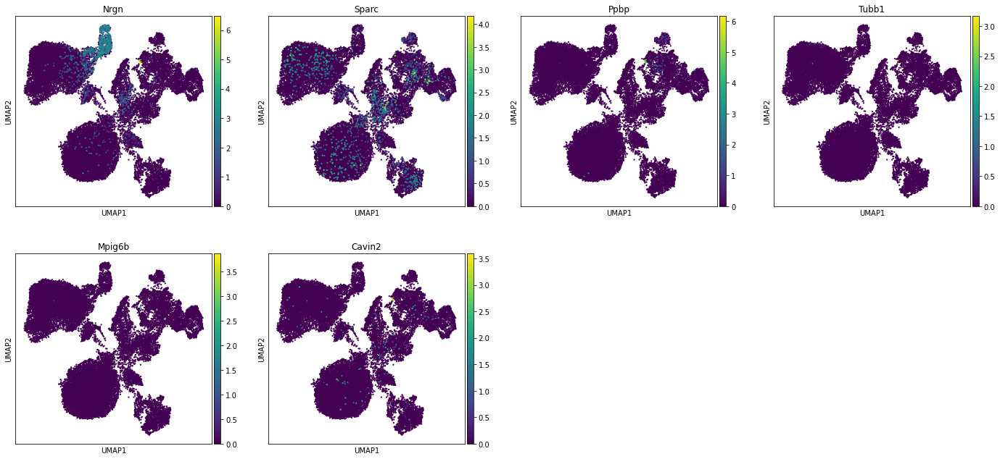

pDC


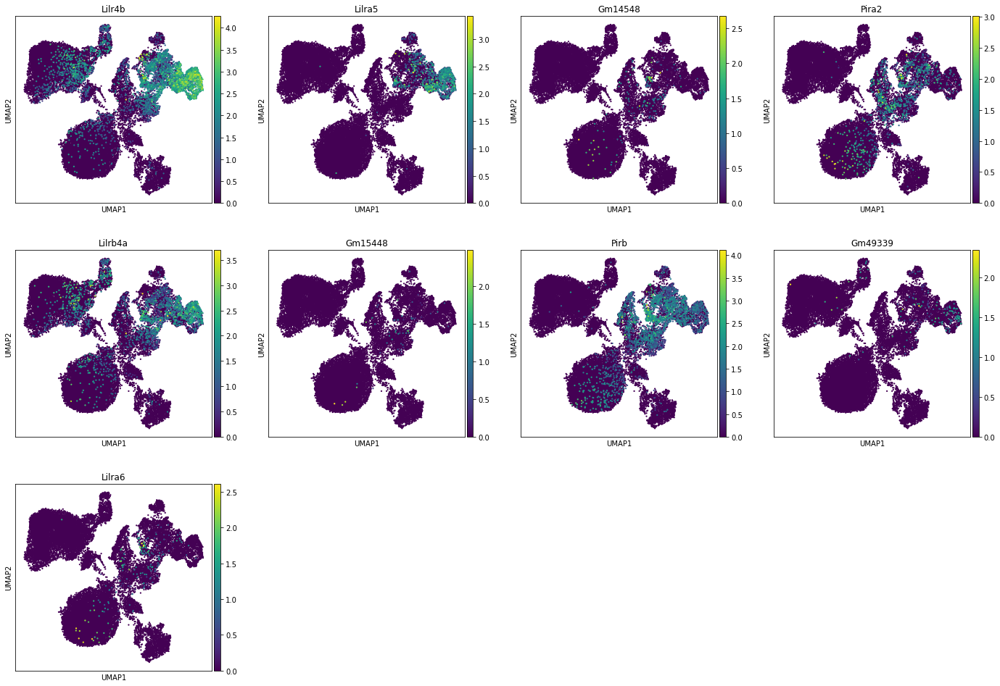

Eryth


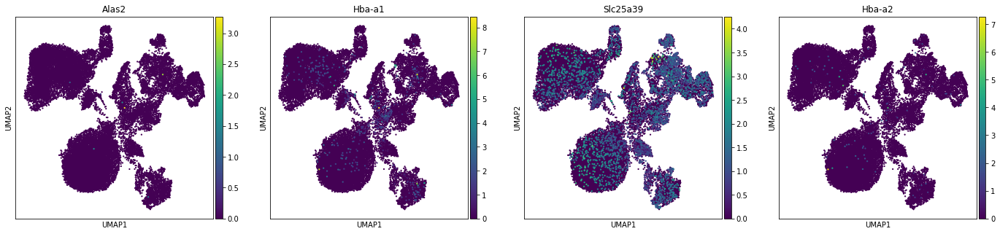

HSPC


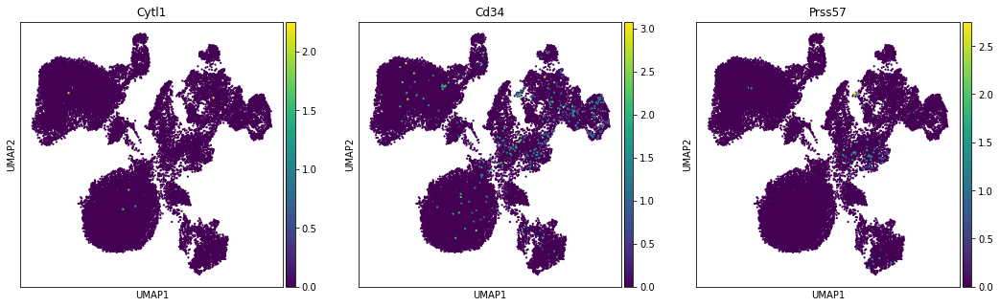

CD4 T


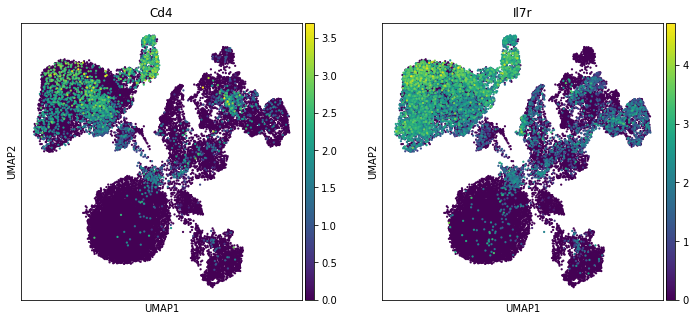

CD8 T


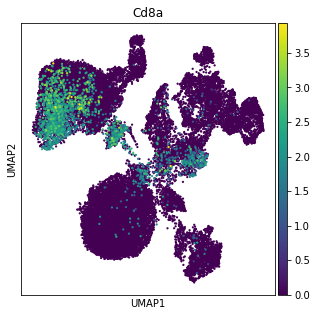

naive/central memory


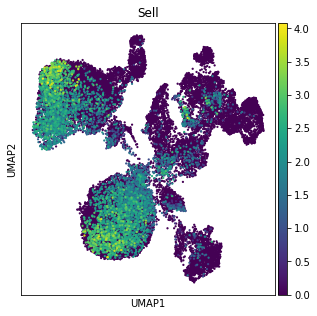

activated


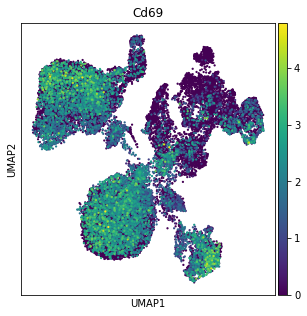

TH1


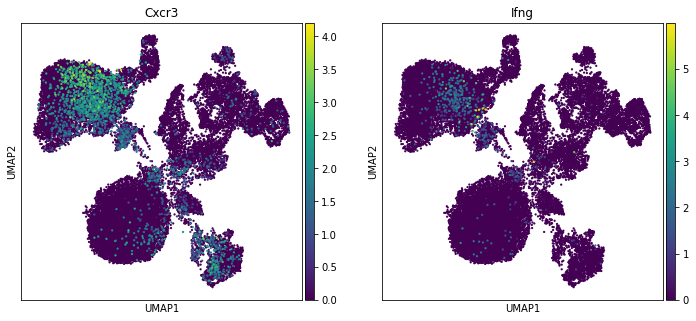

TH17


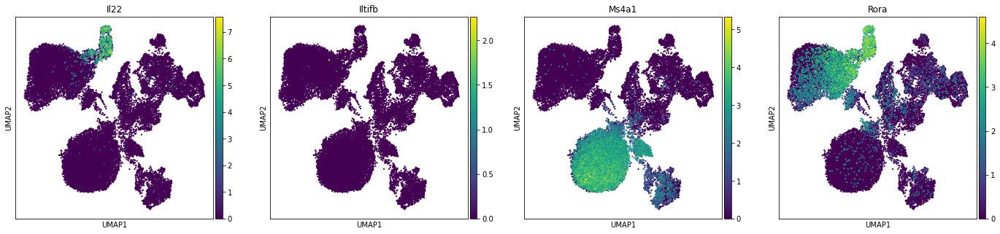

Treg


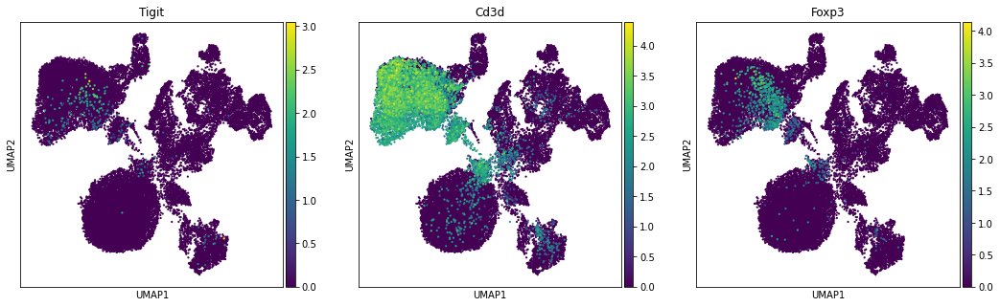

T follicular helper


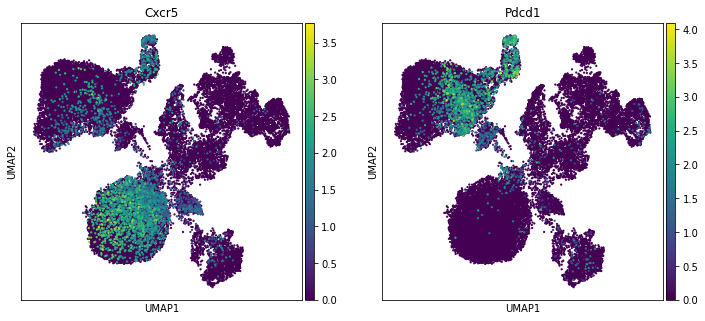

CD8 T memory


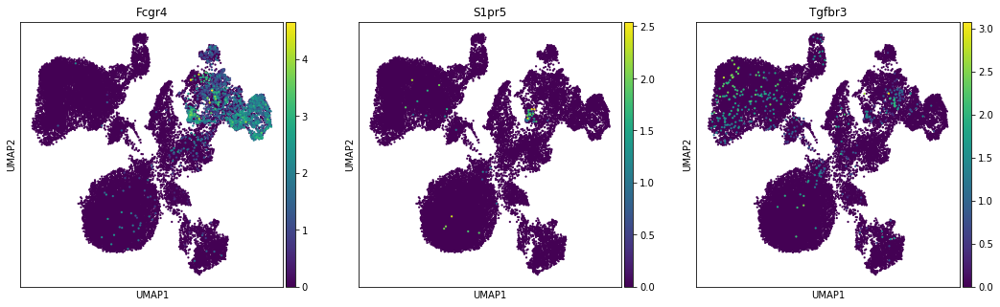

gdT


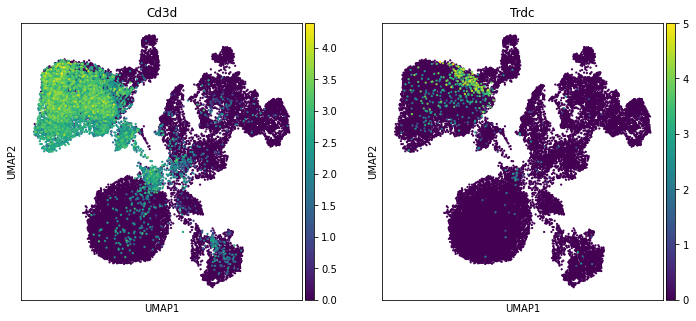

NK T


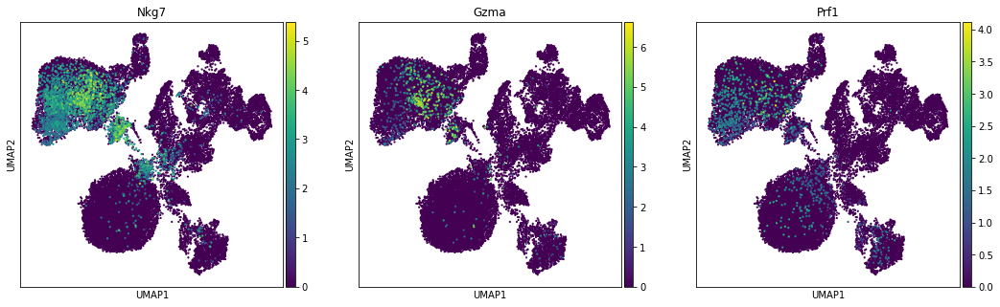

MAIT


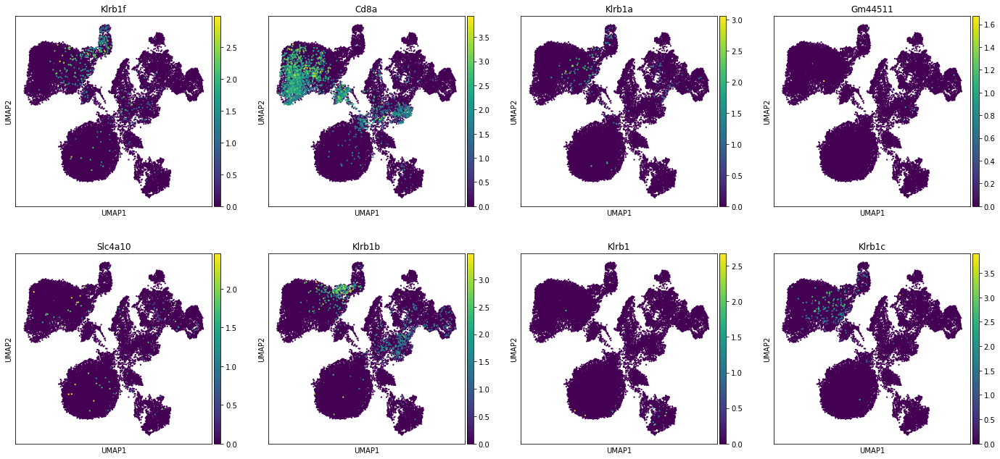

ILC2


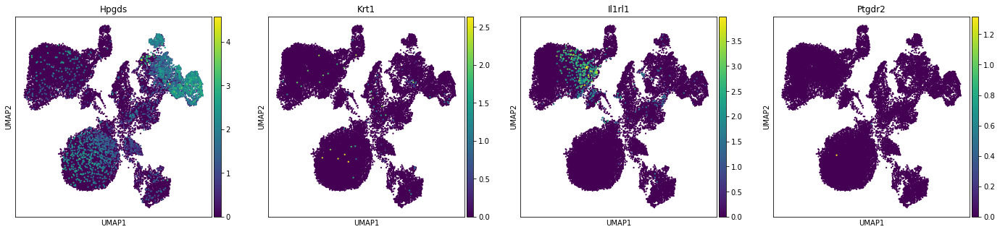

ILC3


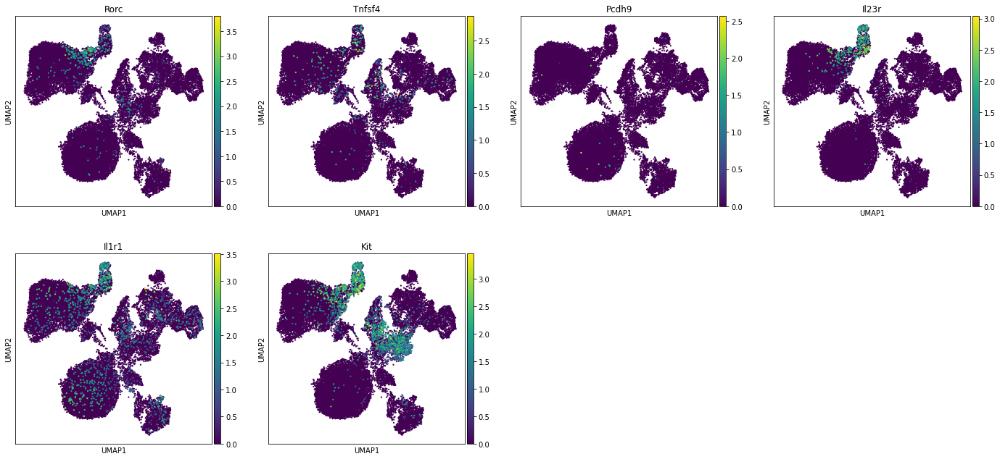

ILCP


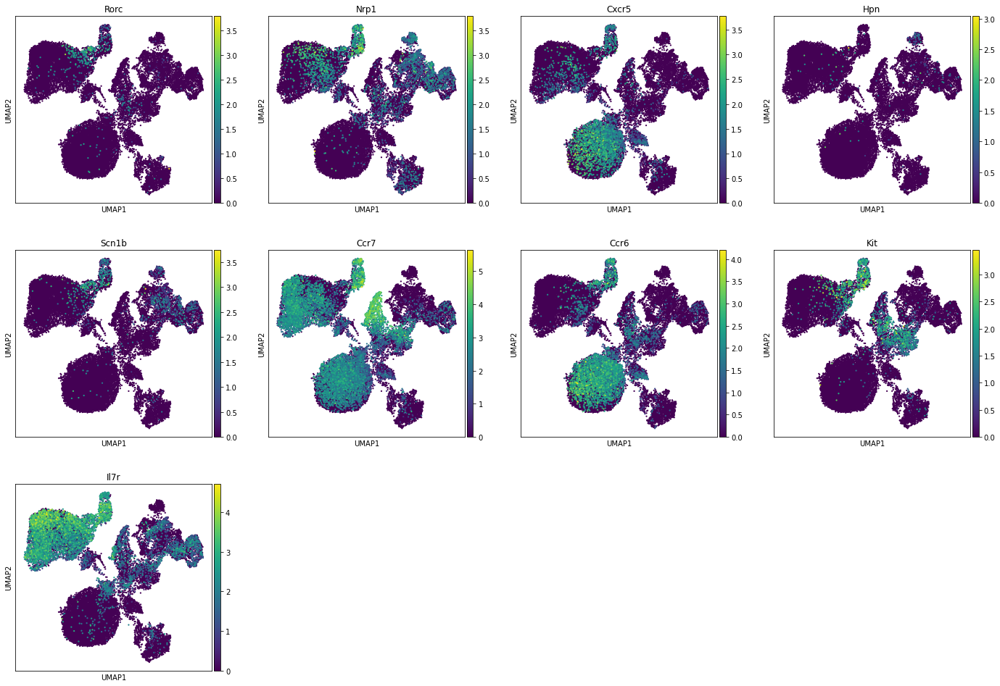

CD4 naive


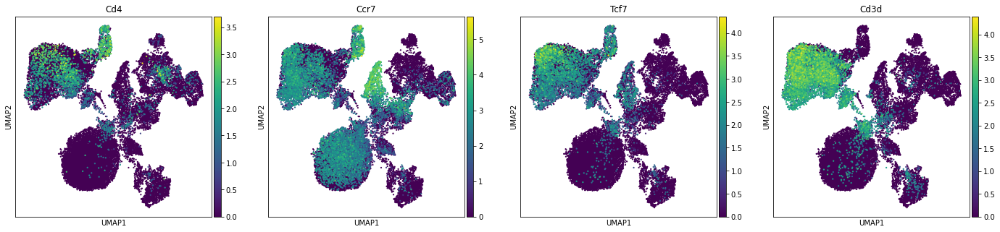

CD8 naive


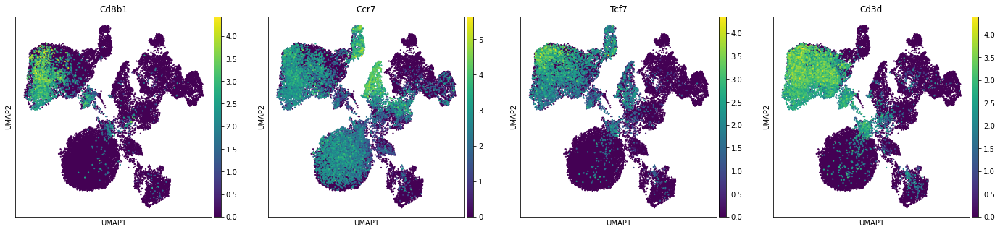

CD8 TEM


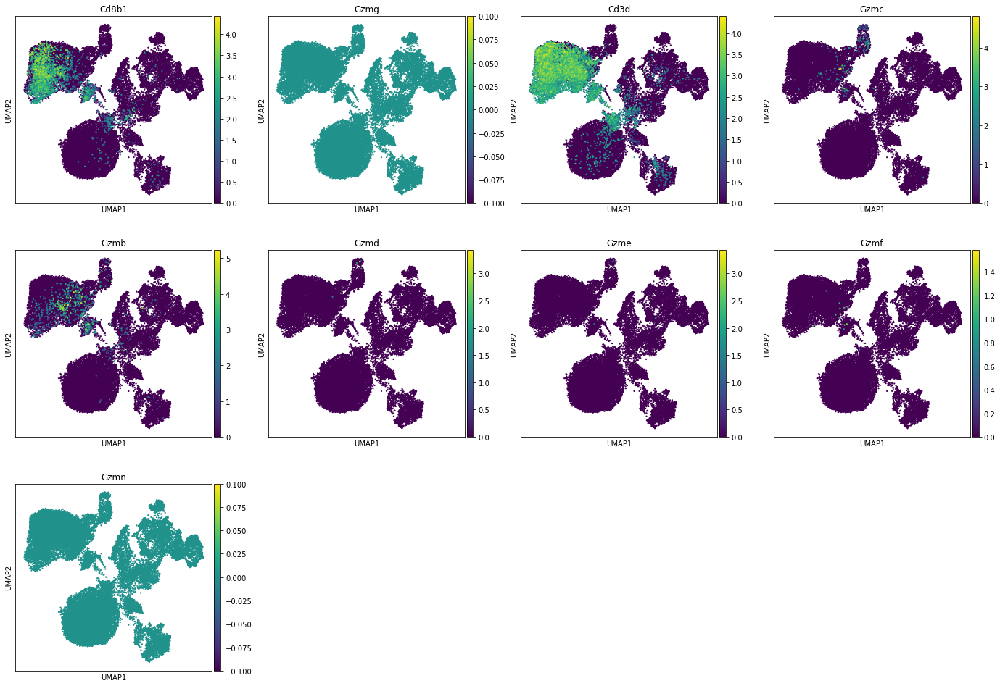

CD4 TEM


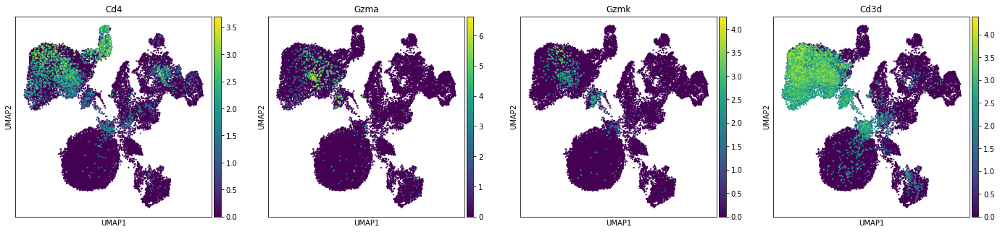

CD8 TCM


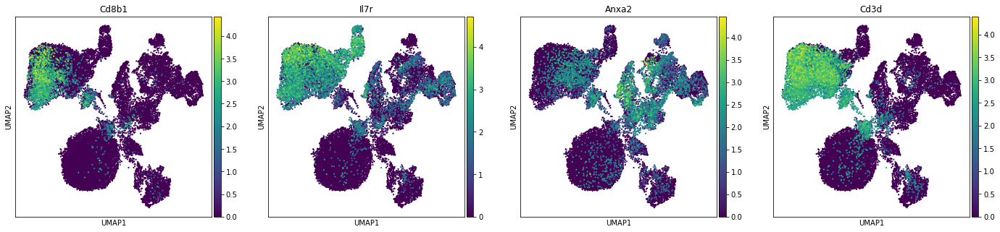

CD4 TCM


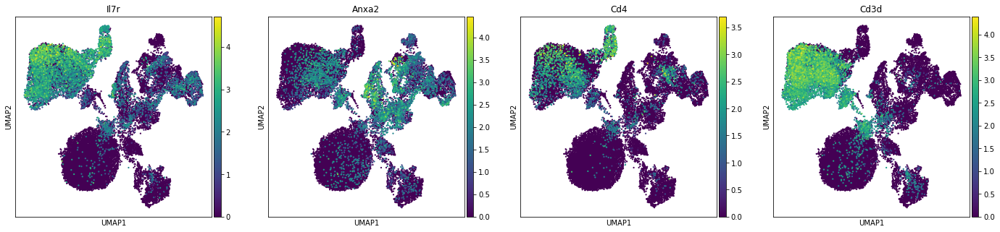

CD4 CTL


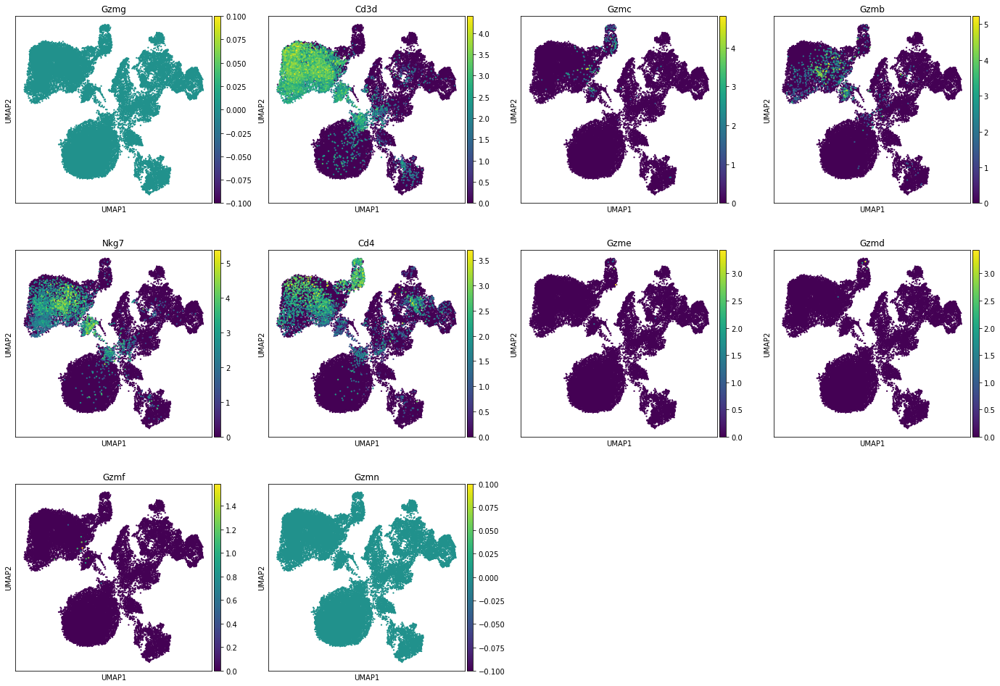

T cycling


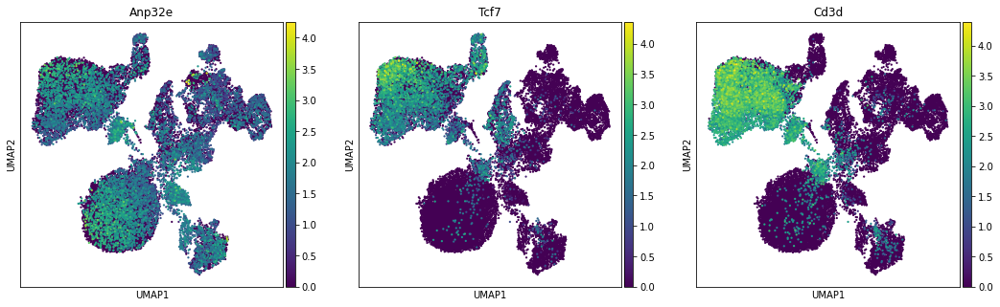

NK_CD56bright


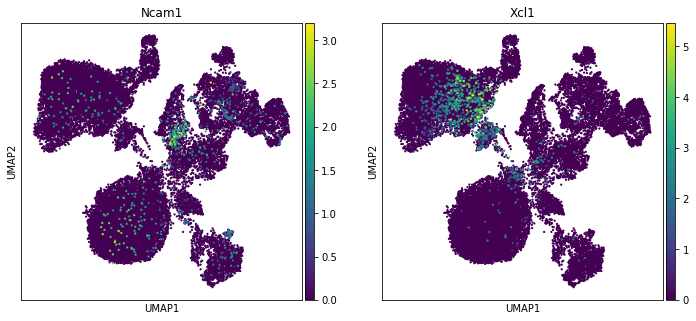

CD4 IL17+


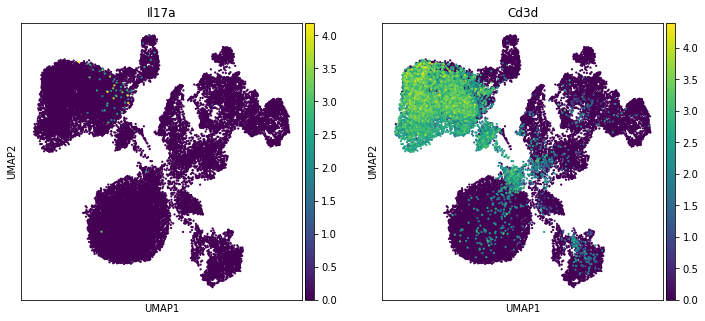

NK_select


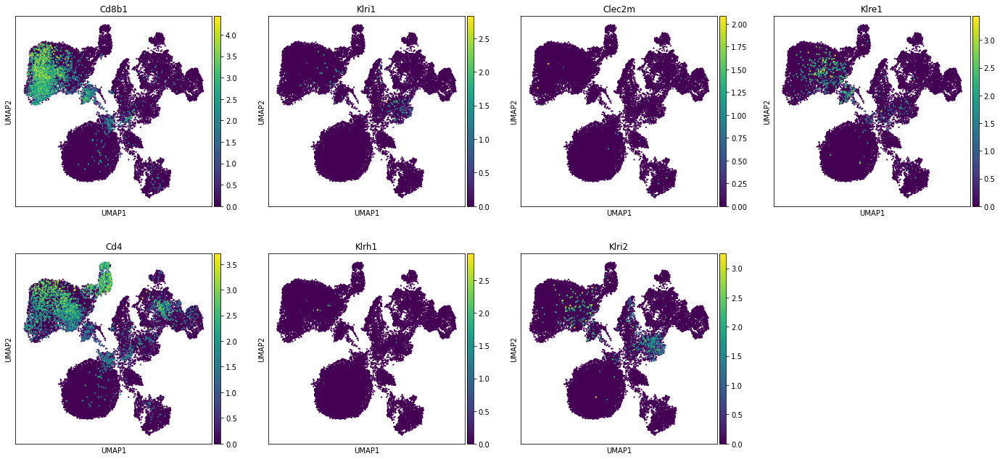

Classical monocytes


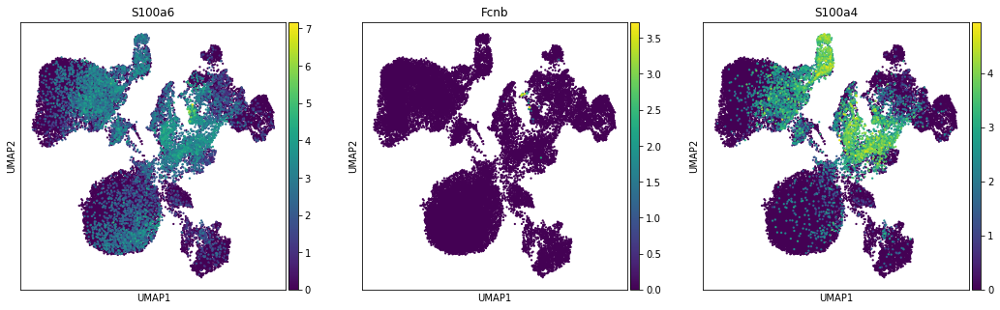

Mast


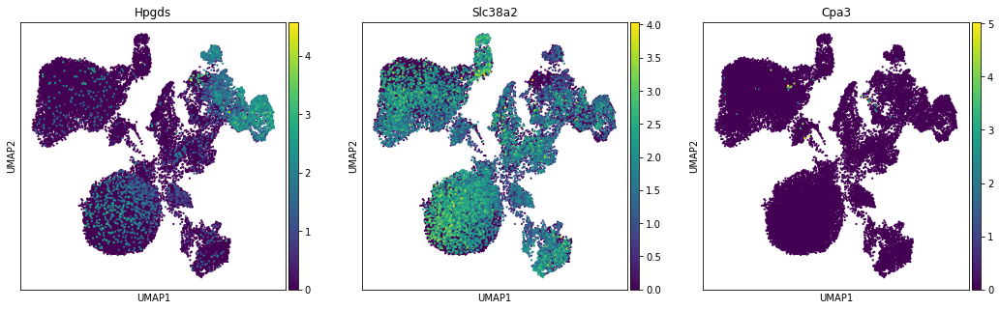

Megakaryocytes


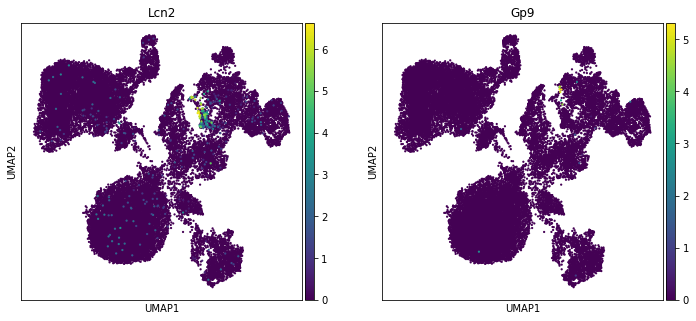

Classical macrophages 


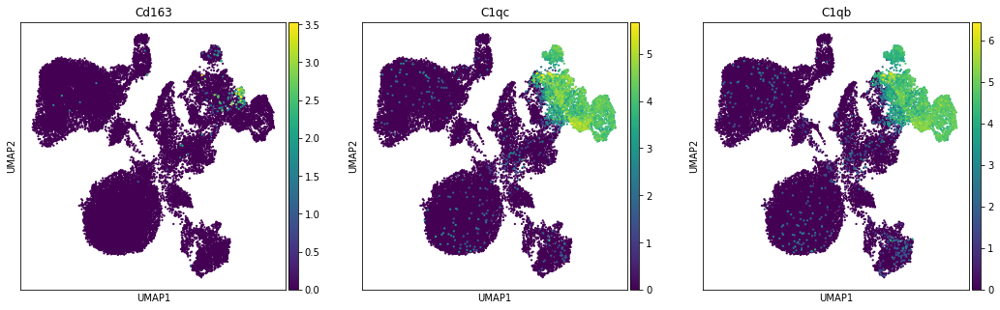

LYVE1+ macrophages


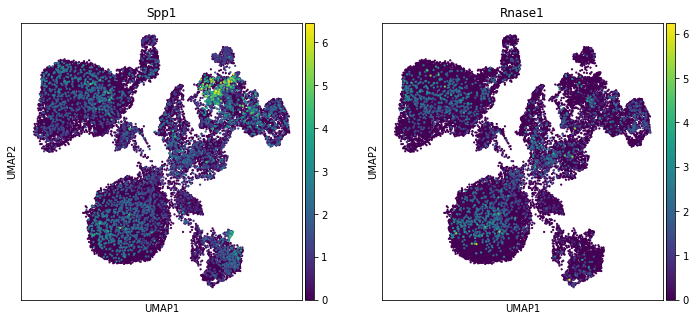

Inflammatory macrophages


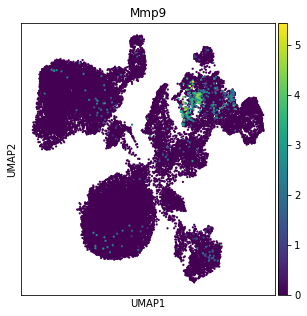

CD16 Mono


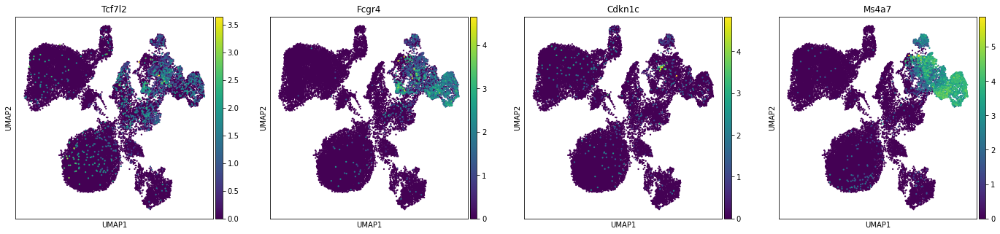

CD14 Mono


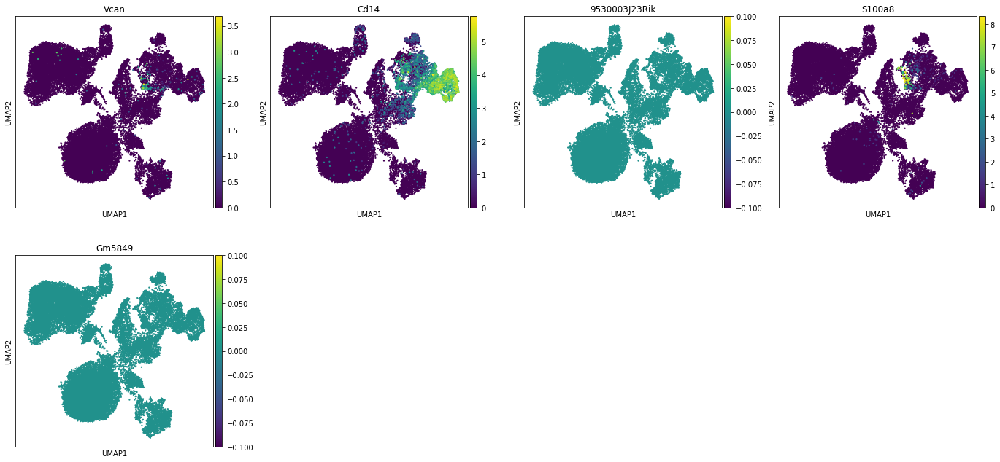

DC1_2


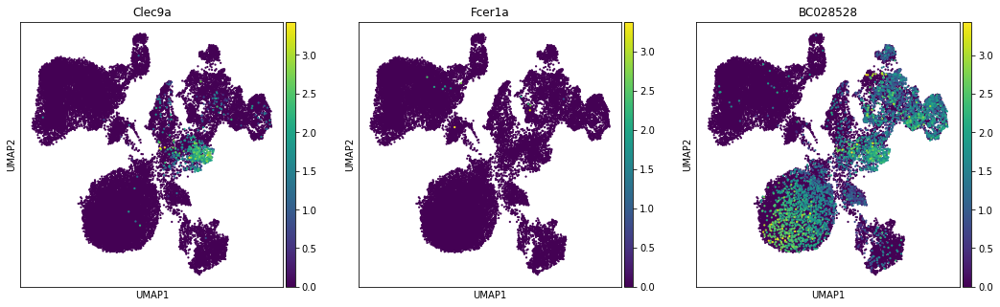

macrophages


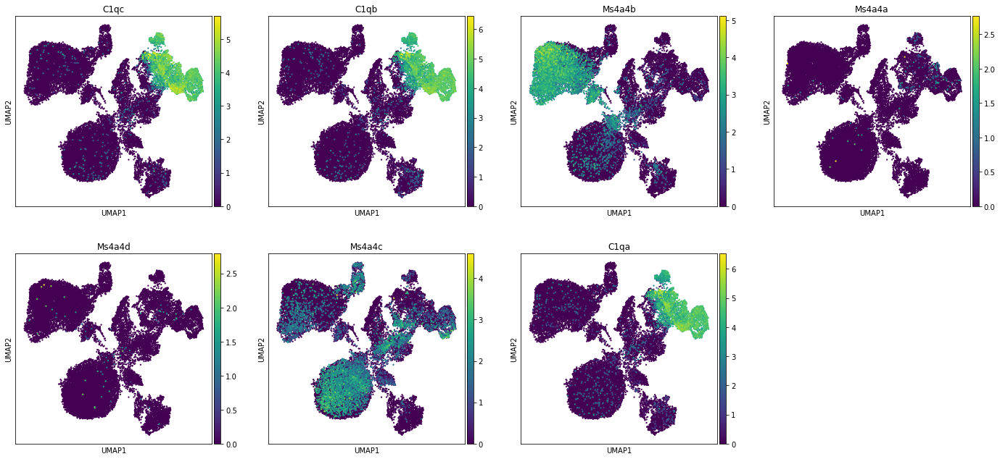

mast cell


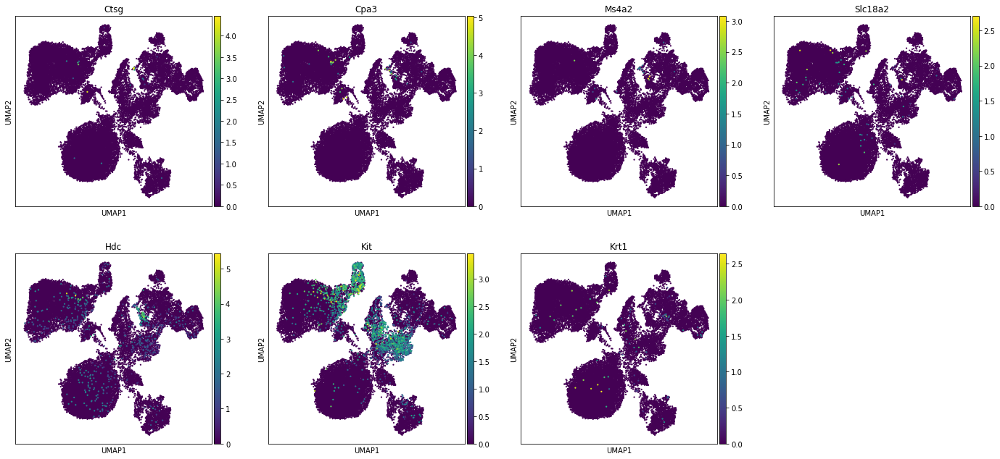

Mast CPA3+


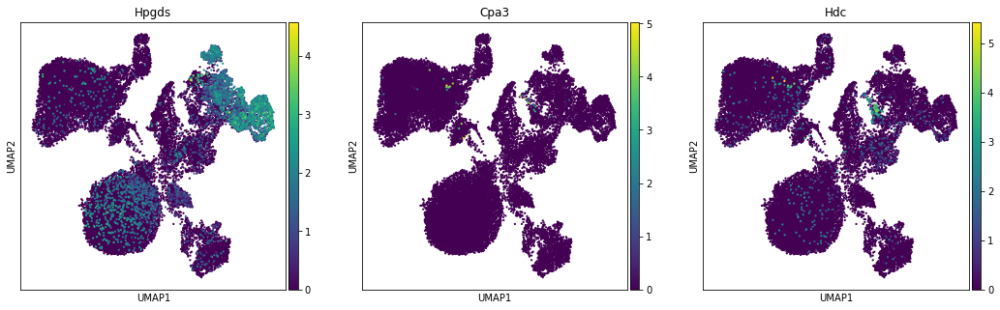

CD14 Mono VCAN+


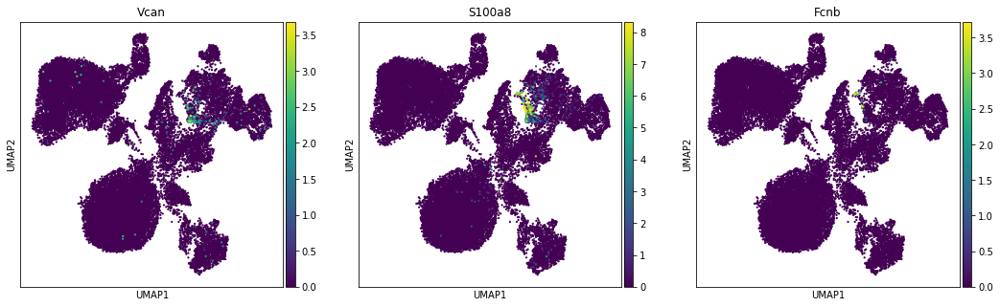

CD16 Mono CDKN1C+


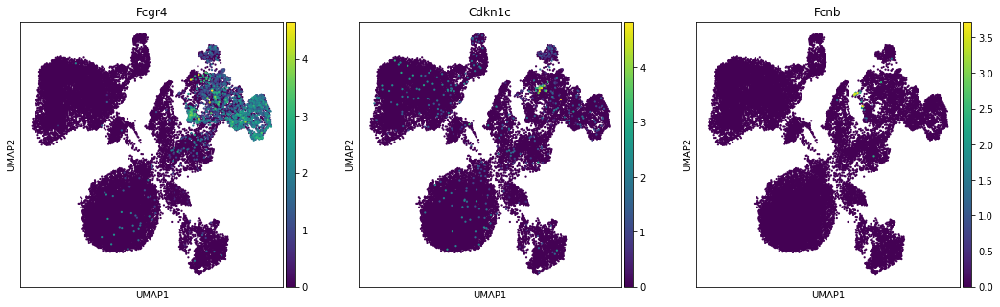

cDC1 CLEC9A+


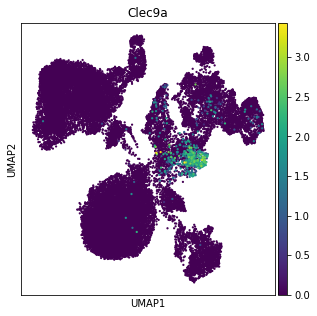

cDC2 CLEC10A+


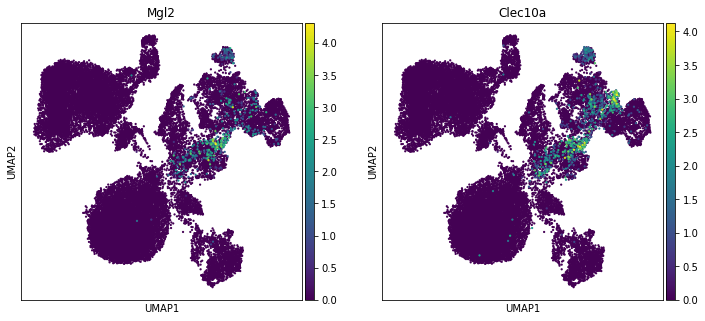

pDC LILRA4+


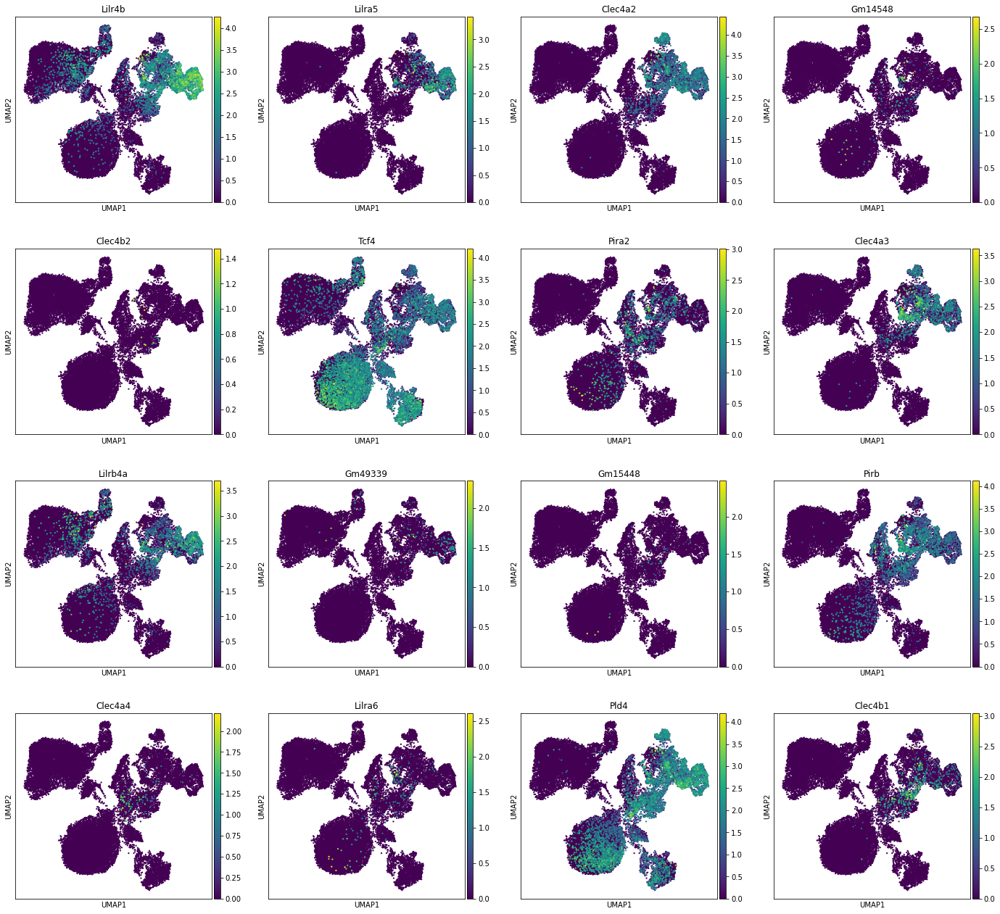

Macrophages


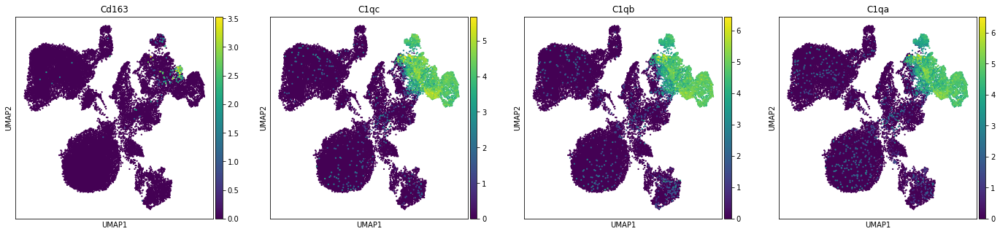

Megakaryocytes GP9


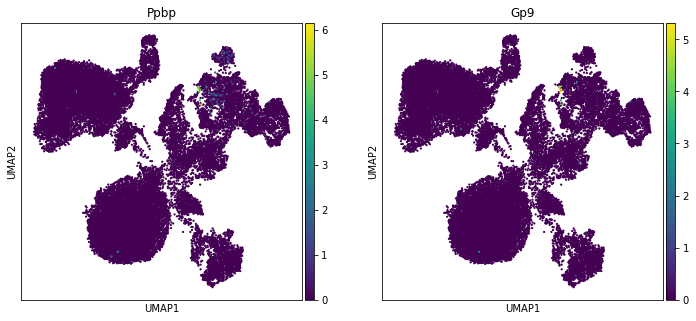

In [13]:
for group,gs in markers.items():
    rcParams['figure.figsize']=(5,5)
    print(group)
    sc.pl.umap(adata_rn,color=[g for g in gs if g in genes_all],
               gene_symbols='gene_symbol',s=20)

Megakaryocytes GP9


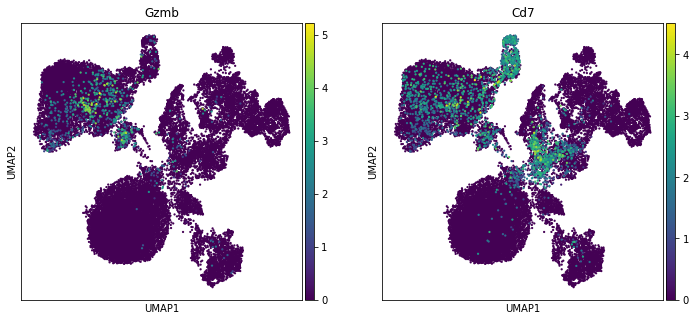

In [15]:
rcParams['figure.figsize']=(5,5)
print(group)
sc.pl.umap(adata_rn,color=['Gzmb','Cd7'], # Should be in gdT
           gene_symbols='gene_symbol',s=20)

B,T,NK, monocyte, plasma, B & T cycling, ILC, macrophage, BT doublet

### Find data-driven markers of each cluster

In [6]:
sc.tl.leiden(adata_rn,resolution=2)

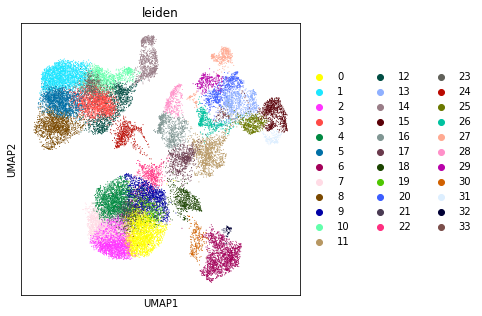

In [15]:
sc.pl.umap(adata_rn,color='leiden')

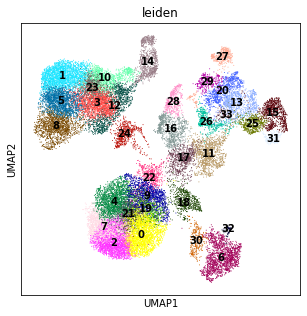

In [77]:
sc.pl.umap(adata_rn,color='leiden',legend_loc='on data')

In [16]:
# Find markers OvR
sc.tl.rank_genes_groups(adata_rn, groupby='leiden')
sc.tl.filter_rank_genes_groups(adata_rn)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/to

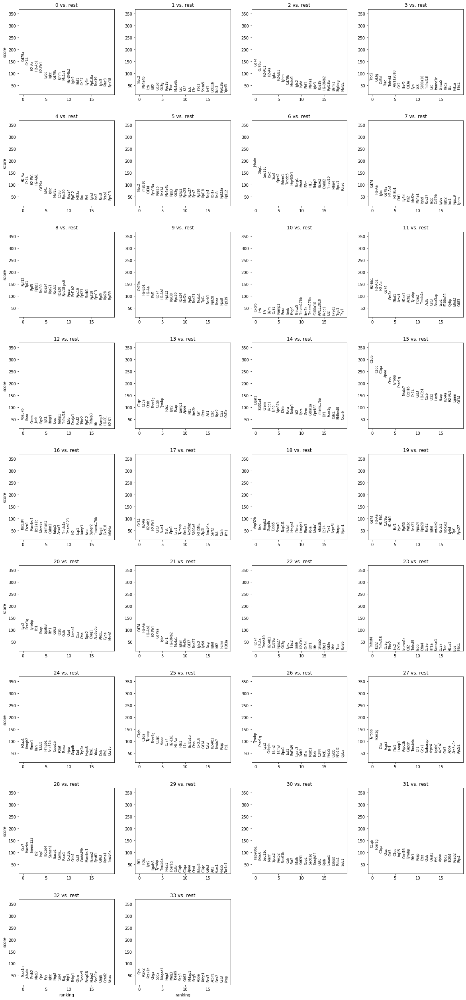

In [17]:
# Markers OVR
sc.pl.rank_genes_groups(adata_rn,gene_symbols ='gene_symbol')

In [26]:
# Save enrichment tables
writer = pd.ExcelWriter(path_save+'immune_clmarkers.xlsx',
                        engine='xlsxwriter') 
for cl in adata_rn.obs['leiden'].cat.categories:
    data=pd.DataFrame({
        'padj':adata_rn.uns['rank_genes_groups']['pvals_adj'][str(cl)],
        'lFC':adata_rn.uns['rank_genes_groups']['logfoldchanges'][str(cl)],
        'EID':adata_rn.uns['rank_genes_groups']['names'][str(cl)],
        'gene_symbol':adata_rn.var.loc[
            adata_rn.uns['rank_genes_groups']['names'][str(cl)],'gene_symbol'],
        'retained':[isinstance(n,str) 
                    for n in adata_rn.uns['rank_genes_groups_filtered']['names'][str(cl)]]
    })
    data.to_excel(writer, sheet_name=str(cl))   
writer.save()

In [27]:
path_save+'immune_clmarkers.xlsx'

'/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/combined/ct_composition/subtypes/immune_clmarkers.xlsx'

### Annotation

Evaluate study distribution not to cretae potential batch-driven clusters.

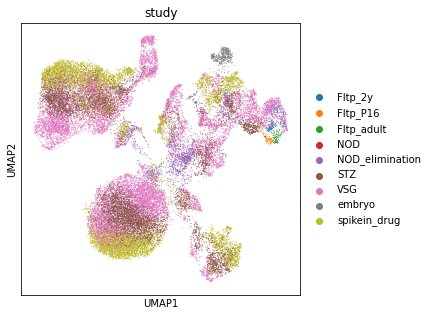

In [11]:
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata_rn,color='study')

Add annotation names - saved as tab names in corresponding excel file

In [7]:
annotation = pd.ExcelFile(path_save+'immune_clmarkers_annotated.xlsx').sheet_names
print(annotation)

['B_cells_1', 'CD4+T_naive', 'B_cells_2', 'CD4+T_mem', 'foB_cells', 'CD8+T_naive', 'B_cells_3', 'B_cells_4', 'CD8+T', 'B_cells_5', 'NKT', 'DCa', 'CD4+NKT', 'M1MØ_1', 'gdT', 'M1MØ_2', 'DCb', 'DCc', 'B_naive', 'B_cells_6', 'Mono_1', 'Siglecg+B', 'CD4+T', 'CD4+T_mem_2', 'CD8+T_eff', 'Trem2+MØ', 'NØ', 'M2MØ', 'DCd', 'modMØ_1', 'Lymphoid1', 'M1MØ_3', 'Lymphoid2', 'modMØ_2']


In [8]:
# Parse annotations to combine overclustered clusters
annotation_parsed=[re.sub(r'_\d*$', '',a) for a in annotation ]
print(annotation_parsed)

['B_cells', 'CD4+T_naive', 'B_cells', 'CD4+T_mem', 'foB_cells', 'CD8+T_naive', 'B_cells', 'B_cells', 'CD8+T', 'B_cells', 'NKT', 'DCa', 'CD4+NKT', 'M1MØ', 'gdT', 'M1MØ', 'DCb', 'DCc', 'B_naive', 'B_cells', 'Mono', 'Siglecg+B', 'CD4+T', 'CD4+T_mem', 'CD8+T_eff', 'Trem2+MØ', 'NØ', 'M2MØ', 'DCd', 'modMØ', 'Lymphoid1', 'M1MØ', 'Lymphoid2', 'modMØ']


In [9]:
# Map clusters
annotation_map=dict(zip(adata_rn.obs['leiden'].cat.categories,annotation))
adata_rn.obs['cell_subtype_v0']=adata_rn.obs.leiden.map(annotation_map)
annotation_map=dict(zip(adata_rn.obs['leiden'].cat.categories,annotation_parsed))
adata_rn.obs['cell_subtype_v0_parsed']=adata_rn.obs.leiden.map(annotation_map)

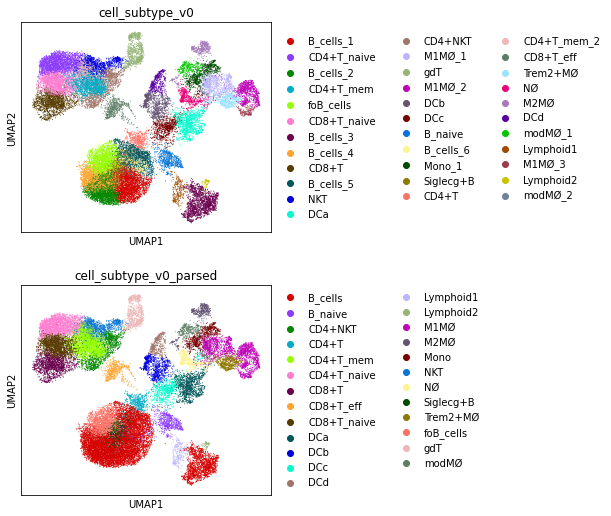

In [12]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rn,color=['cell_subtype_v0','cell_subtype_v0_parsed'],
           palette=sb.color_palette(cc.glasbey, 
                                    n_colors=adata_rn.obs['cell_subtype_v0'].nunique()),ncols=1)

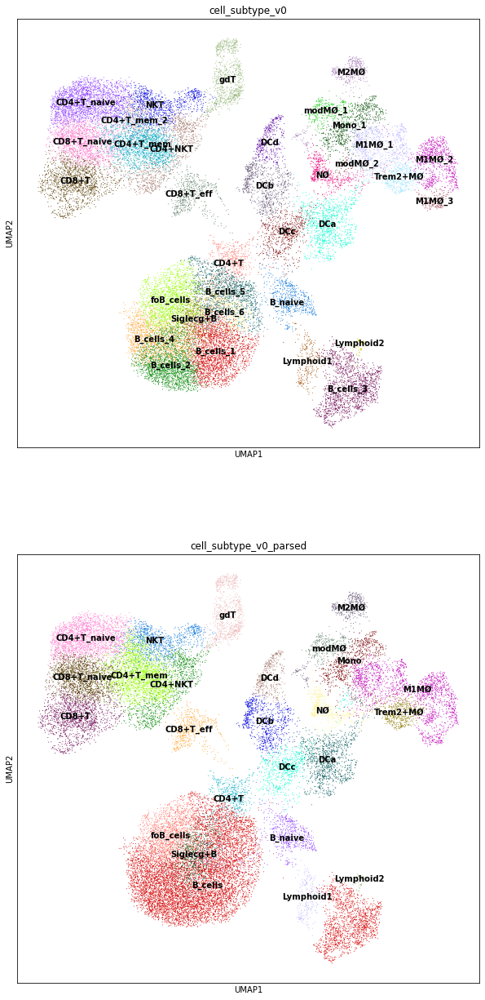

In [11]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata_rn,color=['cell_subtype_v0','cell_subtype_v0_parsed'],
           palette=sb.color_palette(cc.glasbey, 
                                    n_colors=adata_rn.obs['cell_subtype_v0'].nunique()),
           ncols=1,legend_loc='on data')

In [41]:
# Parse a few more cell subtypes
adata_rn.obs['cell_subtype_v1_parsed']=adata_rn.obs['cell_subtype_v0_parsed'].copy().astype(str)
adata_rn.obs.loc[adata_rn.obs_names[adata_rn.obs['cell_subtype_v0']=='B_cells_3'],
                 'cell_subtype_v1_parsed']= 'B_cells_Jchain'
#adata_rn.obs['cell_subtype_v1_parsed']=adata_rn.obs['cell_subtype_v1_parsed'].replace({
#    'DCa':'DC1_2_3','DCc':'DC5_6','DCb':'DC4','DCd':"DC4"})
adata_rn.obs['cell_subtype_v1_parsed']=adata_rn.obs['cell_subtype_v1_parsed'].replace({
    'DCb':'DCb','DCd':"DCb"})

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed' as categorical


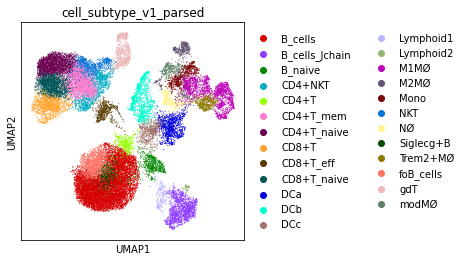

In [42]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed'],
           palette=sb.color_palette(cc.glasbey, 
                                    n_colors=adata_rn.obs['cell_subtype_v0'].nunique()),ncols=1)

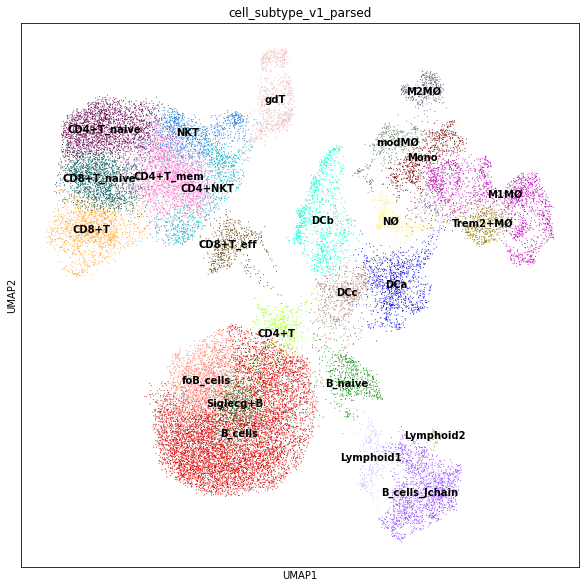

In [43]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed'],
           palette=sb.color_palette(cc.glasbey, 
                                    n_colors=adata_rn.obs['cell_subtype_v0'].nunique()),
           ncols=1,legend_loc='on data')

Coarsen the annotation as the above annotation is not very clear based on markers, may be also affected by batch effects.

In [44]:
# Coarse ct
ct_coarse_map={

     'B_cells':'B',
 'B_cells_Jchain':'B',
 'B_naive':'B',
 'CD4+NKT':'NKT',
 'CD4+T':'T',
 'CD4+T_mem':'T',
 'CD4+T_naive':'T',
 'CD8+T':'T',
 'CD8+T_eff':'T',
 'CD8+T_naive':'T',
 'DCa':'DC',
 'DCb':'DC',
 'DCc':'DC',
 'Lymphoid1':'lymphoid',
 'Lymphoid2':'lymphoid',
 'M1MØ':'macrophage',
 'M2MØ':'macrophage',
 'Mono':'monocyte',
 'NKT':'NKT',
 'NØ':'neutrophil',
 'Siglecg+B':'B',
 'Trem2+MØ':'macrophage',
 'foB_cells':'B',
 'gdT':'T',
 'modMØ':'macrophage'
}
adata_rn.obs['cell_subtype_v1_parsed_coarse']=adata_rn.obs['cell_subtype_v1_parsed'].map(
    ct_coarse_map)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed_coarse' as categorical


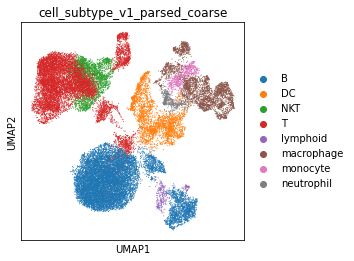

In [45]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed_coarse'],ncols=1)

In [46]:
# Lineage
lineage_map={
    'B':'lymphoid', 
    'DC':'myeloid', 
    'NKT':'lymphoid', 
    'T':'lymphoid', 
    'lymphoid':'lymphoid', 
    'macrophage':'myeloid', 
    'monocyte':'myeloid', 
    'neutrophil':'myeloid'
}
adata_rn.obs['cell_subtype_v1_parsed_lineage']=adata_rn.obs['cell_subtype_v1_parsed_coarse'].map(
    lineage_map)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed_lineage' as categorical


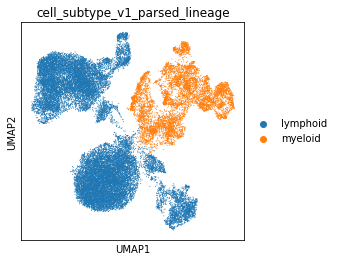

In [47]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed_lineage'],ncols=1)

Make coarse re-annotation as some fine cell types do not look as good, also some re-labeling may be needed

In [18]:
# Coarse ct
ct_coarse_map={
'B_cells':'B',
'B_cells_Jchain':'plasma',
'B_naive':'B_naive-cycling',
'CD4+NKT':'NKT',
'CD4+T':'double_negative-BT_doublet',
'CD4+T_mem':'T',
'CD4+T_naive':'T',
'CD8+T':'T',
'CD8+T_eff':'CD8+T_eff-T_cycling',
'CD8+T_naive':'T',
'DCa':'DC',
'DCb':'DC',
'DCc':'DC',
'Lymphoid1':'lymphoid1-plasma_cycling',
'Lymphoid2':'plasma',
'M1MØ':'macrophage',
'M2MØ':'macrophage',
'Mono':'monocyte-macrophage',
'NKT':'NKT',
'NØ':'neutrophil',
'Siglecg+B':'B',
'Trem2+MØ':'macrophage',
'foB_cells':'B',
'gdT':'gdT-ILC',
'modMØ':'macrophage'

}
adata_rn.obs['cell_subtype_v1_parsed_coarse_v1']=adata_rn.obs['cell_subtype_v1_parsed'].map(
    ct_coarse_map)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed_coarse_v1' as categorical


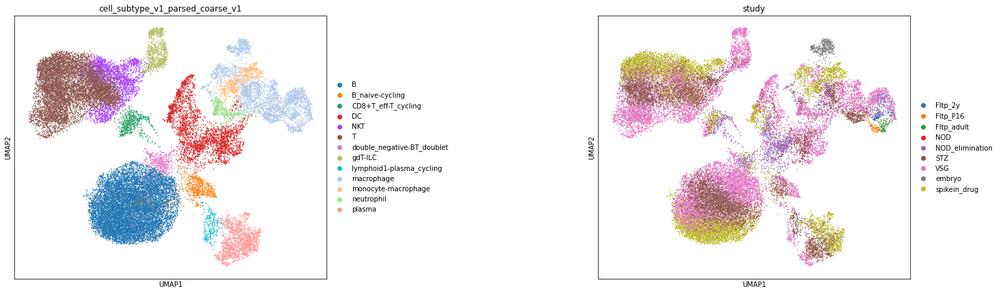

In [67]:
rcParams['figure.figsize']=(7,7)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed_coarse_v1','study'],wspace=0.7,s=10)

Maybe merge plasma1 and 2 into single ct? Markers seem similar

In [68]:
# Find markers OvR
sc.tl.rank_genes_groups(adata_rn, groupby='cell_subtype_v1_parsed_coarse_v1')
sc.tl.filter_rank_genes_groups(adata_rn)

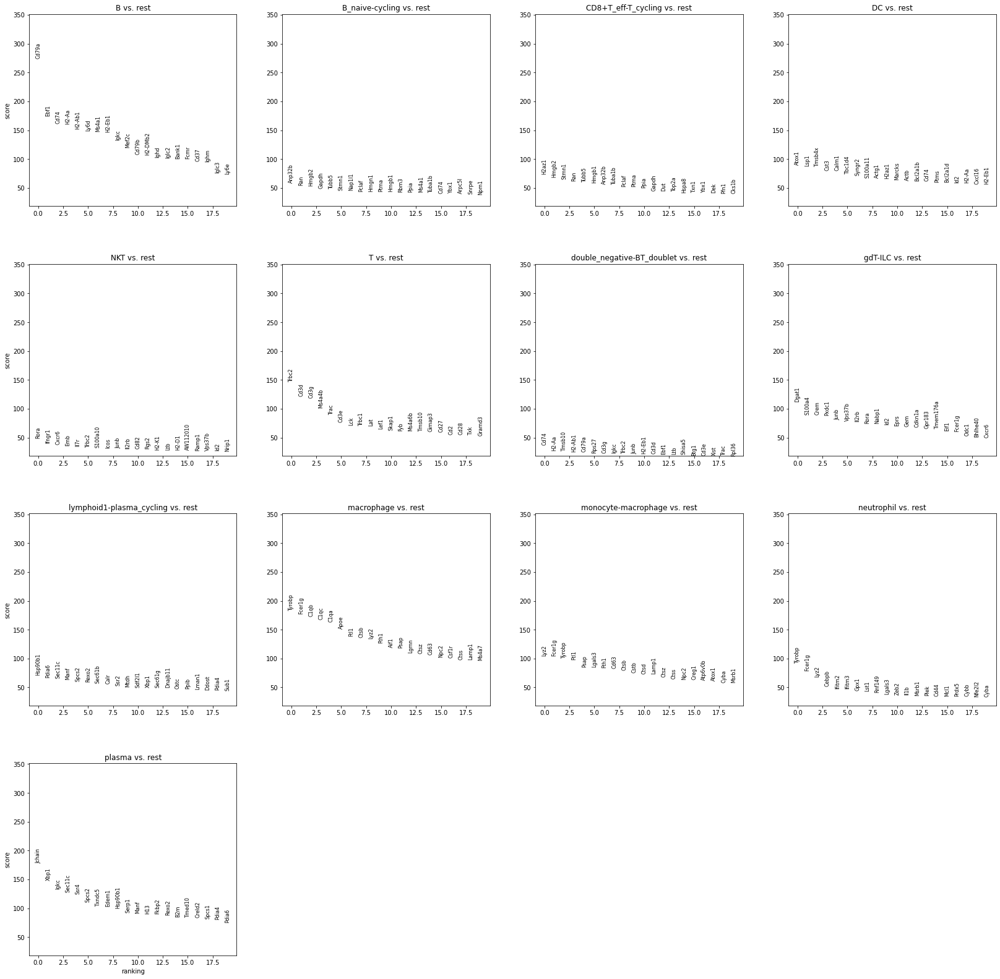

In [69]:
# Markers OVR
sc.pl.rank_genes_groups(adata_rn,gene_symbols ='gene_symbol')

In [70]:
# Save enrichment tables
writer = pd.ExcelWriter(path_save+'immune_clmarkers_coarse_v1.xlsx',
                        engine='xlsxwriter') 
for cl in adata_rn.obs['cell_subtype_v1_parsed_coarse_v1'].cat.categories:
    data=pd.DataFrame({
        'padj':adata_rn.uns['rank_genes_groups']['pvals_adj'][str(cl)],
        'lFC':adata_rn.uns['rank_genes_groups']['logfoldchanges'][str(cl)],
        'EID':adata_rn.uns['rank_genes_groups']['names'][str(cl)],
        'gene_symbol':adata_rn.var.loc[
            adata_rn.uns['rank_genes_groups']['names'][str(cl)],'gene_symbol'],
        'retained':[isinstance(n,str) 
                    for n in adata_rn.uns['rank_genes_groups_filtered']['names'][str(cl)]]
    })
    data.to_excel(writer, sheet_name=str(cl))   
writer.save()

In [71]:
path_save+'immune_clmarkers_coarse_v1.xlsx'

'/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/combined/ct_composition/subtypes/immune_clmarkers_coarse_v1.xlsx'

Plot QC info

In [38]:
# Add doublet scores from each study's data
data_study=[
  ('Fltp_2y','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/islets_aged_fltp_iCre/rev6/'),
  ('Fltp_adult','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/islet_fltp_headtail/rev4/'),
  ('Fltp_P16','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/salinno_project/rev4/'),
  ('NOD','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/GSE144471/'),
  ('NOD_elimination','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/GSE117770/'),
  ('spikein_drug','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/GSE142465/'),
  ('embryo','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/GSE132188/rev7/'),
  ('VSG','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/VSG_PF_WT_cohort/rev7/'),
  ('STZ','/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/islet_glpest_lickert/rev7/')
    ]
for study,path in data_study:
    cells=adata_rn.obs.query('study==@study').index
    cells_parsed=[c.replace('-'+study,'') for c in cells]
    adata_rn.obs.loc[cells,'doublet_score']=sc.read(path+'data_annotated.h5ad',
            backed='r').obs.loc[cells_parsed,'doublet_score'].values

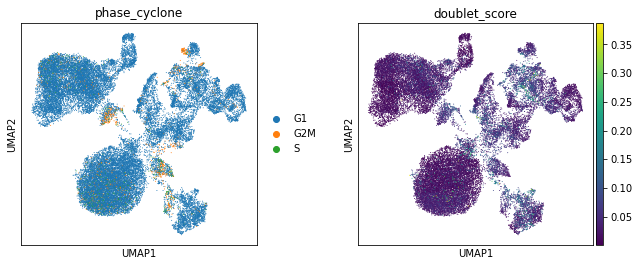

In [41]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rn,color=['phase_cyclone','doublet_score'],wspace=0.3)

##### Final annotation

In [21]:
# Coarse ct
ct_coarse_map={
 'B':'B',
 'B_naive-cycling':'B_cycling',
 'CD8+T_eff-T_cycling':'T_cycling',
 'DC':'DC',
 'NKT':'T',
 'T':'T',
 'double_negative-BT_doublet':'B_T_doublet',
 'gdT-ILC':'T',
 'lymphoid1-plasma_cycling':'plasma_cycling',
 'macrophage':'macrophage_monocyte',
 'monocyte-macrophage':'macrophage_monocyte',
 'neutrophil':'neutrophil',
 'plasma':'plasma'

}
adata_rn.obs['cell_subtype_v1_parsed_coarse_v2']=adata_rn.obs['cell_subtype_v1_parsed_coarse_v1'].map(
    ct_coarse_map)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed_coarse_v1' as categorical
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_subtype_v1_parsed_coarse_v2' as categorical


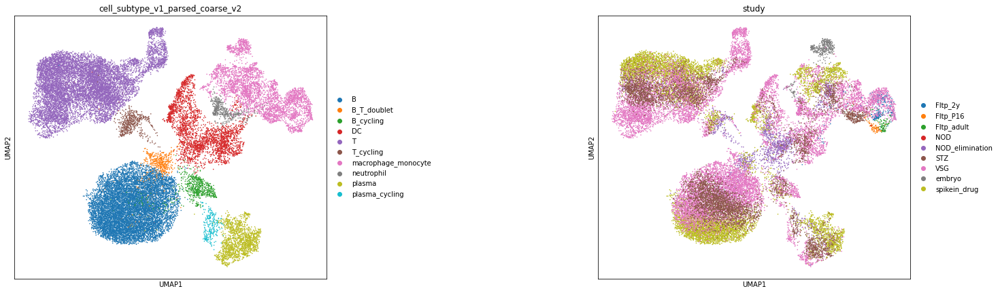

In [22]:
rcParams['figure.figsize']=(7,7)
sc.pl.umap(adata_rn,color=['cell_subtype_v1_parsed_coarse_v2','study'],wspace=0.7,s=10)

In [44]:
# Find markers OvR
sc.tl.rank_genes_groups(adata_rn, groupby='cell_subtype_v1_parsed_coarse_v2')
sc.tl.filter_rank_genes_groups(adata_rn)

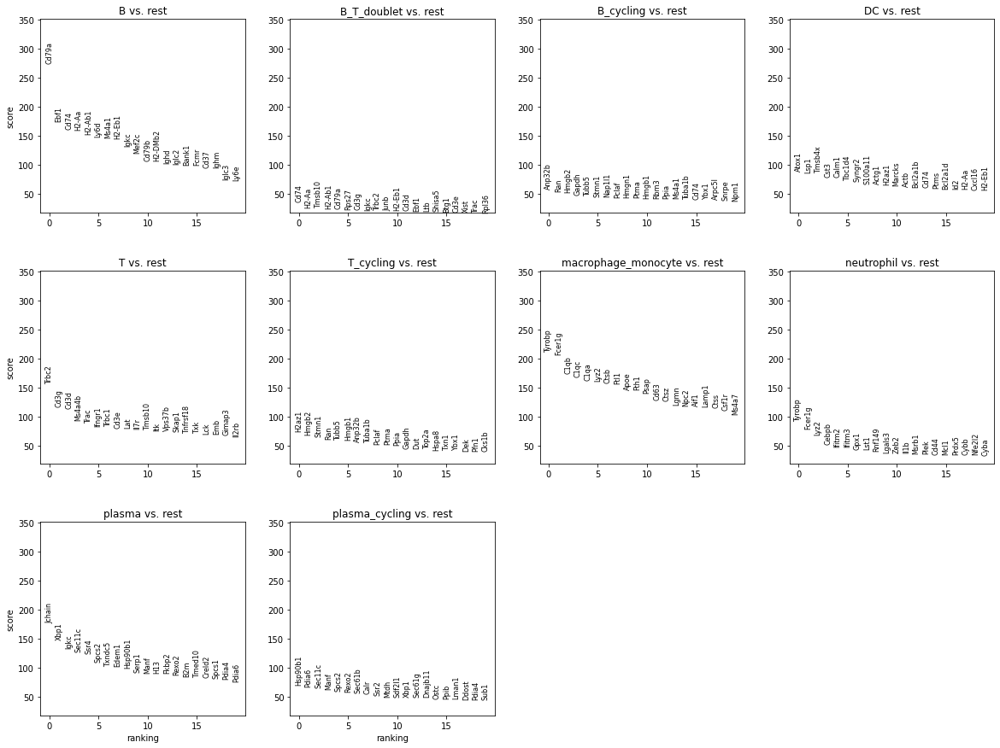

In [45]:
# Markers OVR
sc.pl.rank_genes_groups(adata_rn,gene_symbols ='gene_symbol')

Plot some genes defined as B or T markers to see if we have these doublets really

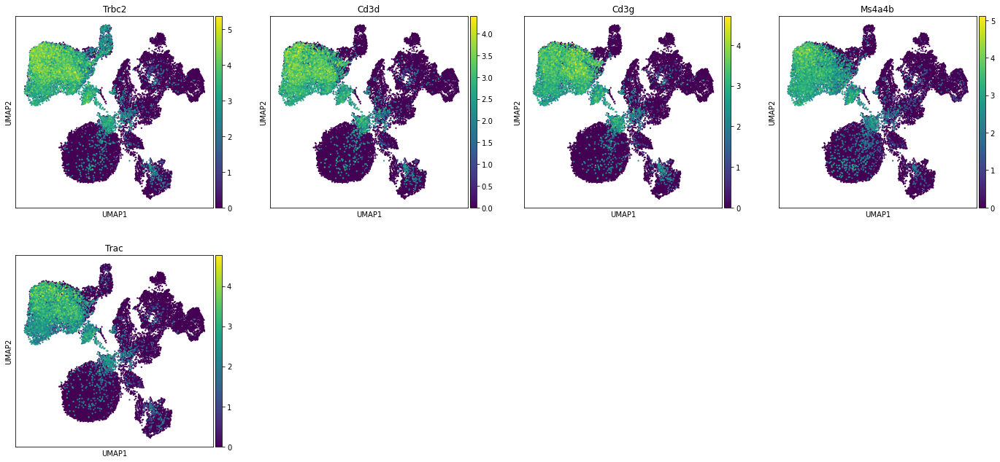

In [49]:
# T cell data-driven markers
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata_rn,color=['Trbc2','Cd3d','Cd3g','Ms4a4b','Trac'], # Should be in T
           gene_symbols='gene_symbol',s=20)

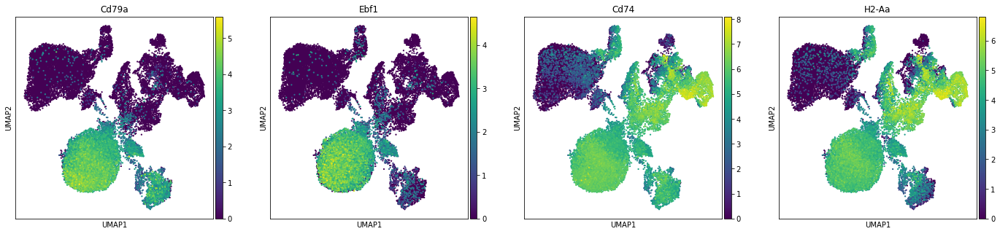

In [47]:
# B cell data-driven markers
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata_rn,color=['Cd79a','Ebf1','Cd74','H2-Aa'], # Should be in B
           gene_symbols='gene_symbol',s=20)

#### Save

In [50]:
adata_rn

AnnData object with n_obs × n_vars = 31703 × 30672
    obs: 'study_sample', 'study', 'file', 'reference', 'size_factors_sample', 'S_score', 'G2M_score', 'phase', 'phase_cyclone', 's_cyclone', 'g2m_cyclone', 'g1_cyclone', 'sex', 'pre_cell_type', 'ins_score', 'ins_high', 'gcg_score', 'gcg_high', 'sst_score', 'sst_high', 'ppy_score', 'ppy_high', 'cell_filtering', 'age', 'design', 'strain', 'tissue', 'technique', 'internal_id', 'batch', 'study_sample_design', 'cell_type', 'cell_type_multiplet', 'cell_subtype', 'cell_subtype_multiplet', 'size_factors_integrated', 'leiden', 'cell_subtype_v0', 'cell_subtype_v0_parsed', 'cell_subtype_v1_parsed', 'cell_subtype_v1_parsed_coarse', 'cell_subtype_v1_parsed_lineage', 'cell_subtype_v1_parsed_coarse_v1', 'cell_subtype_v1_parsed_coarse_v2', 'doublet_score'
    var: 'gene_symbol', 'used_integration', 'gene_symbol_original_matched'
    uns: 'cell_subtype_v0_colors', 'cell_subtype_v0_parsed_colors', 'cell_subtype_v1_parsed_coarse_colors', 'cell_subtype_v1

In [51]:
adata_rn.write(path_data+'data_rawnorm_integrated_analysed_immune.h5ad')

In [3]:
# reload
adata_rn=sc.read(path_data+'data_rawnorm_integrated_analysed_immune.h5ad')

## Proportion changes in T2D

In [3]:
obs=sc.read(path_data+'data_rawnorm_integrated_analysed_immune.h5ad',backed='r').obs.copy()

Subset to relevant T2D samples

In [4]:
samples=['STZ_G2_STZ','STZ_G1_control','VSG_MUC13633_chow_WT',
 'VSG_MUC13634_chow_WT', 'VSG_MUC13641_sham_Lepr-/-', 'VSG_MUC13639_sham_Lepr-/-',]
obs_sub=obs.query('study_sample_design in @samples ').copy()

obs_sub['study_sample_design'].unique()

['VSG_MUC13639_sham_Lepr-/-', 'VSG_MUC13633_chow_WT', 'VSG_MUC13634_chow_WT', 'VSG_MUC13641_sham_Lepr-/-', 'STZ_G2_STZ', 'STZ_G1_control']
Categories (56, object): ['Fltp_2y_MUC13974_mRFP', 'Fltp_2y_MUC13975_mTmG', 'Fltp_2y_MUC13976_mGFP', 'Fltp_P16_145_mGFP_mGFP', ..., 'spikein_drug_SRR10751513_A10_r3', 'spikein_drug_SRR10751514_DMSO_r3', 'spikein_drug_SRR10751515_FOXO_r3', 'spikein_drug_SRR10751516_GABA_r3']

In [7]:
pd.crosstab(obs_sub['study_sample_design'],obs_sub['cell_subtype_v1_parsed_coarse_v2'])

cell_subtype_v1_parsed_coarse_v2,B,B_T_doublet,B_cycling,DC,T,T_cycling,macrophage_monocyte,neutrophil,plasma,plasma_cycling
study_sample_design,,,,,,,,,,
STZ_G1_control,1,0,0,5,2,0,81,2,0,0
STZ_G2_STZ,508,1,47,117,305,11,96,10,91,53
VSG_MUC13633_chow_WT,5,0,0,2,3,0,122,0,0,0
VSG_MUC13634_chow_WT,9,0,0,2,2,0,97,1,0,0
VSG_MUC13639_sham_Lepr-/-,274,10,2,204,518,12,304,25,0,0
VSG_MUC13641_sham_Lepr-/-,1244,57,18,439,1669,34,154,27,22,0


In [5]:
# Proportions of cells per ct
props=pd.crosstab(obs_sub['study_sample_design'],obs_sub['cell_subtype_v1_parsed_coarse_v2'],
                  normalize='index')

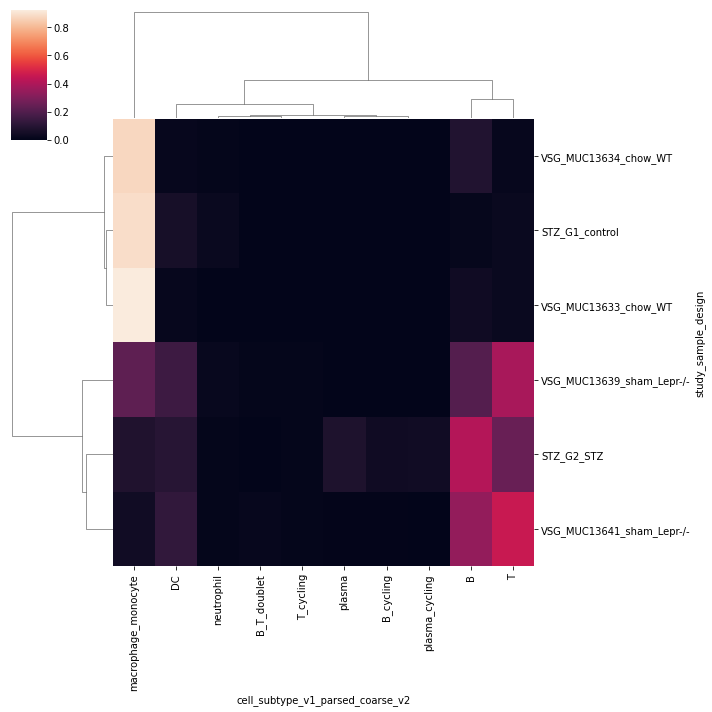

In [6]:
sb.clustermap(props)

C: Unclear if this may be technical or true bio effect. 